<a href="https://colab.research.google.com/github/4nif1234/Portofolio_Linkedin/blob/main/final_project_Hanif_Dwi_Satria_Fraud%20Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Fraud Detection Dataset

In [ ]:
# 1. Bersihkan versi lama pandas terlebih dahulu
!pip uninstall -y pandas

# 2. Install versi pandas yang kompatibel
!pip install pandas==1.5.3

# 3. Upgrade xarray untuk dukungan ke pandas 1.5.3
!pip install --upgrade xarray

# 4. Install semua library lainnya
!pip install shap matplotlib seaborn plotly scipy==1.11.4
!pip install dalex
!pip install scikit-plot
!pip install lime

Found existing installation: pandas 2.3.1
Uninstalling pandas-2.3.1:
  Successfully uninstalled pandas-2.3.1
  Using cached pandas-1.5.3-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (11 kB)
Using cached pandas-1.5.3-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.0 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 1.5.3 which is incompatible.
arviz 0.22.0 requires pandas>=2.1.0, but you have pandas 1.5.3 which is incompatible.
geopandas 1.1.1 requires pandas>=2.0.0, but you have pandas 1.5.3 which is incompatible.
dask-cudf-cu12 25.6.0 requires pandas<2.2.4dev0,>=2.0, but you have pandas 1.5.3 which is incompatible.
plotnine 0.14.5 requires pandas>=2.2.0, but you have pandas 1.5.3 which is incompatible.
tsfresh 0.21.0 requires scipy>=1.14.0; python_version >= 

In [ ]:
# import pandas for data wrangling
import pandas as pd

pd.__version__

'2.3.1'

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
pd.set_option("display.max_columns", None) # show all columns
pd.set_option("display.max_rows", None) # show all rows

# 1. Business Understanding & Goals

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Final Project Dibimbing (Machine Learning)/Fraud Detection Dataset.csv')
df.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,T1,4174,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,T2,4507,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,T3,1860,2395.02,ATM Withdrawal,NaN,Mobile,NaN,3,115,9,NaN,0
3,T4,2294,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51000 entries, 0 to 50999
Data columns (total 12 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Transaction_ID                    51000 non-null  object 
 1   User_ID                           51000 non-null  int64  
 2   Transaction_Amount                48480 non-null  float64
 3   Transaction_Type                  51000 non-null  object 
 4   Time_of_Transaction               48448 non-null  float64
 5   Device_Used                       48527 non-null  object 
 6   Location                          48453 non-null  object 
 7   Previous_Fraudulent_Transactions  51000 non-null  int64  
 8   Account_Age                       51000 non-null  int64  
 9   Number_of_Transactions_Last_24H   51000 non-null  int64  
 10  Payment_Method                    48531 non-null  object 
 11  Fraudulent                        51000 non-null  int64  
dtypes: f

Today's, we're gonna talk about in the most phenomenon news, fraud. Fraud is someone to manipulate some of information that related to some of data situation. In this case of bank, people always do giving some of information, maybe misconception, fake news, or something else with data. So, in this case, we have to search more or identified which some of data that cause of frauding data. In that dataset, there's some of information really related to the bank :

File `Fraud Detection Dataset.csv` berisi berbagai kolom, masing-masing mewakili atribut yang berbeda dari data penjualan. Berikut adalah deskripsi singkat dari setiap kolom:

| Nama Kolom                       | Deskripsi                                |
|----------------------------------|------------------------------------------|
| Transaction ID                   | Unique ID of Transaction                 |
| User_ID                          | Unique ID of Transaction User            |
| Transaction_Amount               | Amount of transaction of user            |
| Transaction_Type                 | The Type transaction of payment_method   |
| Time_Of_Transaction              | The time when transaction (in part days) |
| Device_Used                      | The product use when doing transaction   |
| Location                         | Located when doing the transaction       |
| Previous_Fraudulent_Transactions | Sum of people when doing transaction before|
| Account_Age                      | Age when making Account                  |
| Number_of_Transactions_Last_24H  | Sum people doing transaction in last 24 H|
| Payment_Method                   | The Method of payment in transaction     |
| Fraudulent                       | The Indication fraudalent (1) or not (0) |

# 2. Data Cleaning

## A. Handling Duplicated Data

In [ ]:
len(df.drop_duplicates()) / len(df)
#jika output dari code di cell ini tidak bernilai 1 maka terdapat duplikat

0.9827254901960785

In [ ]:
# Menampilkan baris yang memiliki duplikat berdasarkan semua kolom, nanti hanya pilih 1 saja, karena yang duplikat hanya 44 baris
duplicates = df[df.duplicated(keep=False)]

print("Baris dengan duplikat:")
duplicates

Baris dengan duplikat:


,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0
147,T148,3640,3372.43,ATM Withdrawal,19.0,Mobile,Houston,0,65,12,UPI,0
167,T168,3454,2055.94,Online Purchase,12.0,Mobile,Miami,4,68,13,UPI,0
199,T200,3790,4429.89,ATM Withdrawal,17.0,NaN,Miami,1,39,6,UPI,1
262,T263,1663,4887.25,Online Purchase,14.0,Desktop,New York,2,75,4,Credit Card,0
292,T293,1854,4239.73,Online Purchase,23.0,Desktop,Boston,3,10,12,UPI,0
314,T315,3327,NaN,Bank Transfer,6.0,Mobile,Los Angeles,1,67,4,Invalid Method,0
416,T417,2603,1301.03,POS Payment,19.0,Desktop,Houston,1,21,4,Net Banking,1
672,T673,4171,2373.58,ATM Withdrawal,11.0,Desktop,Seattle,1,91,8,Credit Card,0
708,T709,2440,3369.29,Online Purchase,20.0,Desktop,Houston,1,52,6,Debit Card,0


In [ ]:
#Handling Drop duplicate
df = df.drop_duplicates()

In [ ]:
len(df.drop_duplicates()) / len(df)
#jika output dari code di cell ini tidak bernilai 1 maka terdapat duplikat

1.0

Duplicate Data is lready handling

## B. Handling Missing Value Data

In [ ]:
df.isna().sum()

,0
Transaction_ID,0
User_ID,0
Transaction_Amount,2476
Transaction_Type,0
Time_of_Transaction,2505
Device_Used,2437
Location,2500
Previous_Fraudulent_Transactions,0
Account_Age,0
Number_of_Transactions_Last_24H,0


In [ ]:
df[df.isna().any(axis=1)]

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
2,T3,1860,2395.02,ATM Withdrawal,NaN,Mobile,NaN,3,115,9,NaN,0
8,T9,2638,2318.87,Bank Transfer,NaN,Mobile,San Francisco,4,110,12,Debit Card,0
10,T11,1466,NaN,Online Purchase,3.0,Tablet,Houston,1,4,6,Net Banking,0
14,T15,3135,968.78,ATM Withdrawal,15.0,NaN,San Francisco,1,52,13,Net Banking,0
17,T18,3919,2327.71,Online Purchase,20.0,NaN,Miami,4,21,1,Debit Card,0
23,T24,3391,NaN,ATM Withdrawal,7.0,Mobile,Boston,3,8,10,Net Banking,0
24,T25,2515,2715.14,POS Payment,4.0,NaN,Boston,1,71,10,Net Banking,0
25,T26,4485,NaN,Online Purchase,17.0,Mobile,Miami,2,63,8,UPI,0
39,T40,1474,2411.20,Bank Transfer,19.0,Mobile,New York,4,14,12,NaN,0
48,T49,1189,470.84,POS Payment,NaN,Tablet,New York,1,70,3,Net Banking,0


Based on that null search, there's no anything a weird of each row in column. so, that means we're gonna handle only with NaN / Null

In [ ]:
for column in df.columns:
    print(f"============= {column} =================")
    display(df[column].value_counts())
    print()

============= Transaction_ID =================


,count
Transaction_ID,
T28617,2
T18219,2
T726,2
T7566,2
T32208,2
T20034,2
T44997,2
T39587,2
T31139,2



============= User_ID =================


,count
User_ID,
3134,26
1018,26
2573,26
4534,26
3773,26
3575,25
4747,25
2604,24
4904,24



============= Transaction_Amount =================


,count
Transaction_Amount,
49997.80,503
2092.21,4
1747.31,4
625.92,3
1369.45,3
1228.68,3
3614.01,3
2811.66,3
181.72,3



============= Transaction_Type =================


,count
Transaction_Type,
Bill Payment,10161
Bank Transfer,10110
ATM Withdrawal,9979
POS Payment,9957
Online Purchase,9912



============= Time_of_Transaction =================


,count
Time_of_Transaction,
18.0,2071
15.0,2050
13.0,2047
3.0,2023
17.0,2020
0.0,2013
16.0,2011
11.0,1997
1.0,1996



============= Device_Used =================


,count
Device_Used,
Desktop,15524
Mobile,15321
Tablet,15307
Unknown Device,1530



============= Location =================


,count
Location,
Boston,6037
New York,6003
Seattle,6001
Chicago,5968
Houston,5935
Los Angeles,5910
Miami,5884
San Francisco,5881



============= Previous_Fraudulent_Transactions =================


,count
Previous_Fraudulent_Transactions,
2,10121
0,10101
4,10039
1,9956
3,9902



============= Account_Age =================


,count
Account_Age,
106,469
29,462
100,460
68,458
75,455
69,454
77,454
45,453
10,451



============= Number_of_Transactions_Last_24H =================


,count
Number_of_Transactions_Last_24H,
5,3713
8,3694
7,3671
11,3615
13,3613
3,3579
4,3573
1,3558
10,3548



============= Payment_Method =================


,count
Payment_Method,
UPI,11671
Debit Card,11614
Net Banking,11462
Credit Card,11417
Invalid Method,1527



============= Fraudulent =================


,count
Fraudulent,
0,47652
1,2467


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50119 entries, 0 to 50999
Data columns (total 12 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Transaction_ID                    50119 non-null  object 
 1   User_ID                           50119 non-null  int64  
 2   Transaction_Amount                47643 non-null  float64
 3   Transaction_Type                  50119 non-null  object 
 4   Time_of_Transaction               47614 non-null  float64
 5   Device_Used                       47682 non-null  object 
 6   Location                          47619 non-null  object 
 7   Previous_Fraudulent_Transactions  50119 non-null  int64  
 8   Account_Age                       50119 non-null  int64  
 9   Number_of_Transactions_Last_24H   50119 non-null  int64  
 10  Payment_Method                    47691 non-null  object 
 11  Fraudulent                        50119 non-null  int64  
dtypes: float6

Based on that data list column, there's one row that really not acceptable. The column that i mention before was device used with the filling `Unknown Device`. So, in this case, we have to change that filling, also fill the filling from NaN.

In [ ]:
# Menghitung persentase nilai -1 di kolom transaction amount
100 * len(df[(df['Transaction_Amount'].isna())]) / len(df)

4.940242223508051

In [ ]:
# Menghitung persentase nilai -1 di kolom time of transaction Unknown
100 * len(df[(df['Time_of_Transaction'].isna())]) / len(df)

4.998104511263193

In [ ]:
# Menghitung persentase nilai -1 di kolom Device_Used
100 * len(df[(df['Device_Used'] == 'Unknown Device') | (df['Device_Used'].isna())]) / len(df)

7.915161914643149

In [ ]:
# Menghitung persentase nilai -1 di kolom Location
100 * len(df[(df['Location'].isna())]) / len(df)

4.988128254753686

In [ ]:
# Menghitung persentase nilai -1 di kolom Location
100 * len(df[(df['Payment_Method'].isna())]) / len(df)

4.84447016101678

Based on the percent, the result of each null column is below of 20 %. So, we're gonna handled in numeric for median and category for modus.

In [ ]:
# Menghitung median Rating dari data pelatihan yang tidak bernilai -1 atau NaN pada data train
median_transaction = df[(~df['Transaction_Amount'].isna())]['Transaction_Amount'].median()
median_transaction

2523.58

In [ ]:
# Mengisi nilai missing (baik -1 maupun NaN) pada kolom Rating dengan pengetahuan median dari data train
df['Transaction_Amount'] = df['Transaction_Amount'].apply(lambda x: median_transaction if pd.isna(x) else x)

In [ ]:
# Menghitung median Rating dari data pelatihan yang tidak bernilai -1 atau NaN pada data train
median_time = df[(~df['Time_of_Transaction'].isna())]['Time_of_Transaction'].median()
median_time

12.0

In [ ]:
# Mengisi nilai missing (baik -1 maupun NaN) pada kolom Rating dengan pengetahuan median dari data train
df['Time_of_Transaction'] = df['Time_of_Transaction'].apply(lambda x: median_time if pd.isna(x) else x)

In [ ]:
#Mode imputation Untuk Size
mode_device = df[(df['Device_Used'] != 'Unknown Device') & (~df['Device_Used'].isna())]['Device_Used'].mode()[0]
mode_device

'Desktop'

In [ ]:
#Mode imputation Untuk Size
mode_location = df[~df['Location'].isna()]['Location'].mode()[0]
mode_location

'Boston'

In [ ]:
#Mode imputation Untuk Size
mode_payment = df[~df['Payment_Method'].isna()]['Payment_Method'].mode()[0]
mode_payment

'UPI'

In [ ]:
#implement missing value imputation to train and test, from size mode value in train data
df['Device_Used'] = df['Device_Used'].apply(lambda x: mode_device if pd.isna(x) or x == 'Unknown Device' else x)

In [ ]:
#implement missing value imputation to train and test, from size mode value in train data
df['Location'] = df['Location'].apply(lambda x: mode_location if pd.isna(x) else x)

In [ ]:
#implement missing value imputation to train and test, from size mode value in train data
df['Payment_Method'] = df['Payment_Method'].apply(lambda x: mode_payment if pd.isna(x) else x)

In [ ]:
df.isna().sum()

,0
Transaction_ID,0
User_ID,0
Transaction_Amount,0
Transaction_Type,0
Time_of_Transaction,0
Device_Used,0
Location,0
Previous_Fraudulent_Transactions,0
Account_Age,0
Number_of_Transactions_Last_24H,0


## C. Handling Outlier Data

In [ ]:
# untuk plot Q-Q
import scipy.stats as stats
numeric_columns = df.select_dtypes(include=['number']).columns
numeric_columns

Index(['User_ID', 'Transaction_Amount', 'Time_of_Transaction',
       'Previous_Fraudulent_Transactions', 'Account_Age',
       'Number_of_Transactions_Last_24H', 'Fraudulent'],
      dtype='object')

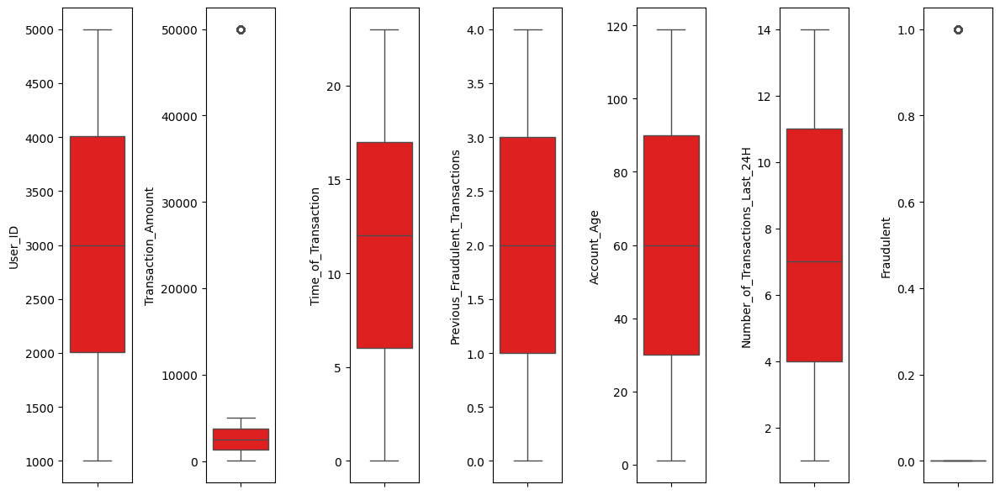

In [ ]:
# adjust the figure size for better readability
plt.figure(figsize=(12,6))

# plotting
for i in range(0, len(numeric_columns)):
    plt.subplot(1, len(numeric_columns), i+1)
    sns.boxplot(y=df[numeric_columns[i]], color='red')
    plt.tight_layout()

Based on outlier, this dataset have it, but it's still kinda normal not very worse (boxplot is smashed). So, we didn't handle that.

# 3. Data Manipulation / EDA

In [ ]:
df.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,T1,4174,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,T2,4507,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,T3,1860,2395.02,ATM Withdrawal,12.0,Mobile,Boston,3,115,9,UPI,0
3,T4,2294,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50119 entries, 0 to 50999
Data columns (total 12 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Transaction_ID                    50119 non-null  object 
 1   User_ID                           50119 non-null  int64  
 2   Transaction_Amount                50119 non-null  float64
 3   Transaction_Type                  50119 non-null  object 
 4   Time_of_Transaction               50119 non-null  float64
 5   Device_Used                       50119 non-null  object 
 6   Location                          50119 non-null  object 
 7   Previous_Fraudulent_Transactions  50119 non-null  int64  
 8   Account_Age                       50119 non-null  int64  
 9   Number_of_Transactions_Last_24H   50119 non-null  int64  
 10  Payment_Method                    50119 non-null  object 
 11  Fraudulent                        50119 non-null  int64  
dtypes: float6

In [ ]:
df_previous = pd.pivot_table(
    data = df,
    index = 'Previous_Fraudulent_Transactions',
    values = 'User_ID',
    aggfunc = 'count'
).reset_index().sort_values(by = 'Previous_Fraudulent_Transactions')
df_previous

,Previous_Fraudulent_Transactions,User_ID
0,0,10101
1,1,9956
2,2,10121
3,3,9902
4,4,10039


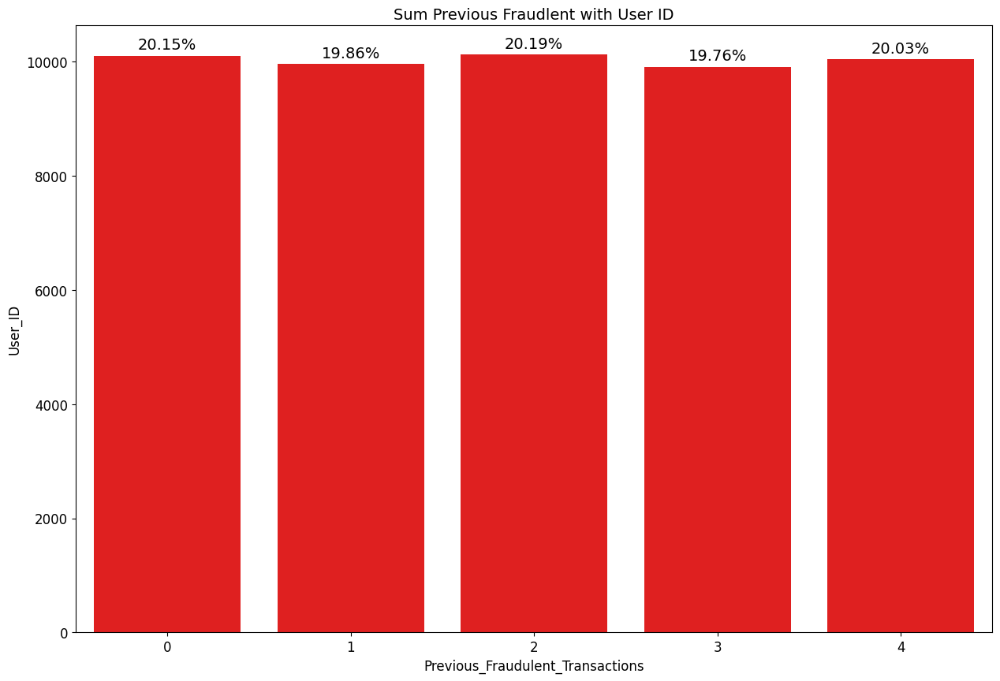

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(15, 10))

total_user = df_previous['User_ID'].sum()

ax = sns.barplot(data=df_previous, x='Previous_Fraudulent_Transactions', y='User_ID', color='red')

# Set the title and labels
plt.title('Sum Previous Fraudlent with User ID', fontsize = 14)
plt.xlabel('Previous_Fraudulent_Transactions', fontsize = 12)
plt.ylabel('User_ID', fontsize = 12)

# Ukuran label axis
plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
#plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / total_user) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black',
            fontsize = 14
        )

1. If there's a lot of time of transaction from time to time, is there any posiible for getting more fraud ?
2. Is there any correlation from category column (Transaction_type,  device_used, etc.) ? Also, is there any correlation from each that components for possibly to fraud ?
3. From the location, is there any difference for each location of fraud ?
4. How was the distribution of customer age with fraud ? is it more higher or low to get fraud ?

Jawaban :

1. if there's a lot of time of transaction from time to time, is there any posiible for getting more fraud ?

In [ ]:
df_time = df.copy()
df_time_1 = df_time[df_time['Fraudulent'] == 1]
df_time_1.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
6,T7,4772,544.81,Bill Payment,2.0,Tablet,Boston,3,6,9,UPI,1
27,T28,3433,4519.04,Bill Payment,13.0,Tablet,Boston,0,81,10,Credit Card,1
43,T44,3047,4413.05,Bank Transfer,21.0,Desktop,Boston,4,46,11,Credit Card,1
68,T69,3363,3517.65,Bill Payment,0.0,Desktop,Boston,2,29,8,UPI,1
73,T74,4417,1440.79,Online Purchase,15.0,Tablet,Miami,2,16,1,Net Banking,1


In [ ]:
df_time_2 = pd.pivot_table(
    data = df_time_1,
    index = 'Time_of_Transaction',
    values = 'Fraudulent',
    aggfunc = 'sum'
).reset_index().sort_values(by = 'Time_of_Transaction')
df_time_2

,Time_of_Transaction,Fraudulent
0,0.0,92
1,1.0,96
2,2.0,101
3,3.0,95
4,4.0,97
5,5.0,89
6,6.0,102
7,7.0,107
8,8.0,94
9,9.0,83


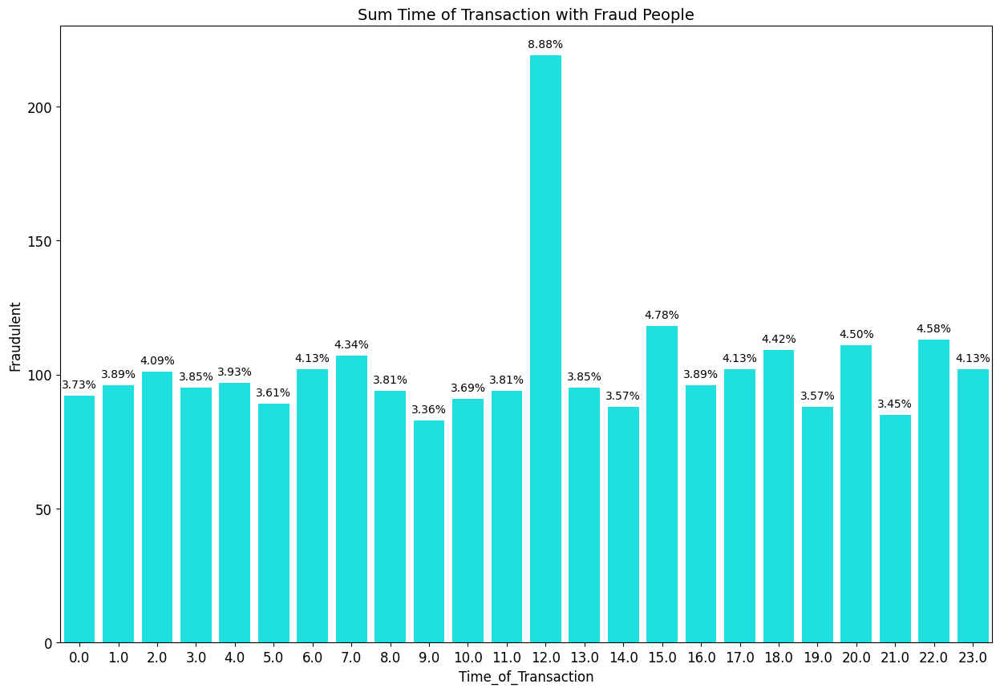

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(15, 10))

total_fraud = df_time_2['Fraudulent'].sum()

ax = sns.barplot(data=df_time_2, x='Time_of_Transaction', y='Fraudulent', color='cyan')

# Set the title and labels
plt.title('Sum Time of Transaction with Fraud People', fontsize = 14)
plt.xlabel('Time_of_Transaction', fontsize = 12)
plt.ylabel('Fraudulent', fontsize = 12)

# Ukuran label axis
plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
#plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / total_fraud) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black'
        )

2. Is there any correlation from category column(Transaction_type, device_used,etc.)? Also, is there any correlation from each that components for possibly to fraud ?

In [ ]:
df_correlation = df.copy()
df_correlation.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,T1,4174,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,T2,4507,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,T3,1860,2395.02,ATM Withdrawal,12.0,Mobile,Boston,3,115,9,UPI,0
3,T4,2294,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
#target_column = ['Fraudulent']

#ordinal_columns = [
#  'PhoneService',
#  'MultipleLines',
#  'InternetService',
#  'OnlineSecurity',
#  'OnlineBackup',
#  'DeviceProtection',
#  'TechSupport',
#  'StreamingTV',
#  'StreamingMovies',
#]

ordinal_columns = ['Fraudulent']

nominal_columns = [
  'Transaction_Type',
  'Device_Used',
  'Location',
  'Payment_Method'
]

category_columns_1 = nominal_columns + ordinal_columns
category_columns = nominal_columns

numeric_columns = [
  'Transaction_Amount',
  'Time_of_Transaction',
  'Previous_Fraudulent_Transactions',
  'Account_Age',
  'Number_of_Transactions_Last_24H',
]

numeric_columns_1 = [
  'Transaction_Amount',
  'Time_of_Transaction',
  'Previous_Fraudulent_Transactions',
  'Account_Age',
  'Number_of_Transactions_Last_24H',
  'Fraudulent'
]

#numeric_columns_1 = numeric_columns + target_column

In [ ]:
from google.colab import drive

import numpy as np

import pandas as pd

from scipy.stats import chi2_contingency, ttest_ind
from scipy.stats.contingency import association

import seaborn as sns

import shap

from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
  classification_report,
  PrecisionRecallDisplay,
  RocCurveDisplay,
)
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.preprocessing import (
  LabelEncoder,
  MinMaxScaler,
  OneHotEncoder,
  OrdinalEncoder,
)

import xgboost as xgb

pd.set_option("display.max_columns", None) # show all columns
pd.set_option("display.max_rows", None) # show all rows

In [ ]:
def show_relationship_category_category(column1, column2):
  df_temp = df_correlation.pivot_table(
    index = column1,
    columns = column2,
    values = 'User_ID',
    aggfunc = 'nunique',
  )
  #df_temp = df_temp.fillna(0)
  df_temp = df_temp.astype(int)

  res = chi2_contingency(df_temp)
  coef = round(association(df_temp, method='cramer'), 2)

  return df_temp, ('' if res.pvalue > 0.05 else '< 0.05'), coef

In [ ]:
df_corr_cat_cat = pd.DataFrame()

for i in range(len(category_columns)):
  column1 = category_columns[i]
  for j in range(i+1, len(category_columns)):
    column2 = category_columns[j]
    _, pvalue, coef = show_relationship_category_category(column1, column2)

    df_temp = pd.DataFrame({
      'column1': [column1],
      'column2': [column2],
      'pvalue': [pvalue],
      'coef': [coef],
    })
    df_corr_cat_cat = pd.concat([df_corr_cat_cat, df_temp])

df_corr_cat_cat

,column1,column2,pvalue,coef
0,Transaction_Type,Device_Used,,0.01
0,Transaction_Type,Location,,0.01
0,Transaction_Type,Payment_Method,,0.01
0,Device_Used,Location,,0.01
0,Device_Used,Payment_Method,< 0.05,0.02
0,Location,Payment_Method,,0.01


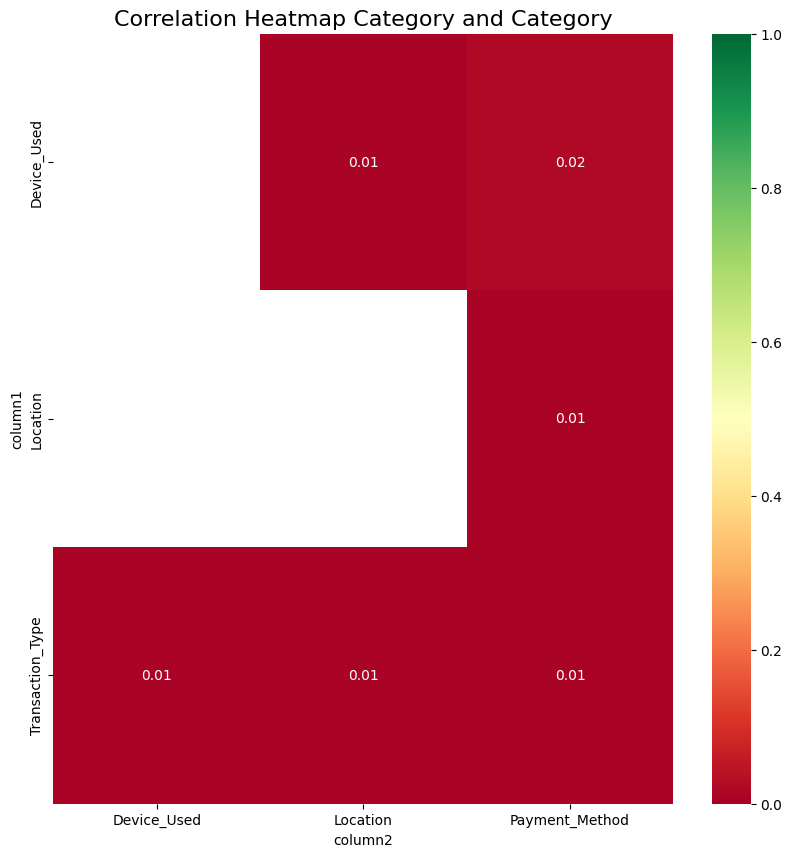

In [ ]:
df_temp = df_corr_cat_cat.pivot_table(
  index='column1',
  columns='column2',
  values='coef',
)

for column1 in df_corr_cat_cat['column1']:
  for column2 in df_corr_cat_cat['column2']:
    if np.isnan(df_temp.loc[column1, column2]) and column1 < column2:
      df_temp.loc[column1, column2] = df_temp.loc[column2, column1]
      df_temp.loc[column2, column1] = None

plt.figure(figsize=(10, 10))
sns.heatmap(
  df_temp,
  vmin = 0,
  vmax = 1,
  cmap = 'RdYlGn',
  fmt=".2f",
  annot=True,
  annot_kws={"fontsize": 7}
)
plt.title('Correlation Heatmap Category and Category', fontsize=16)
plt.show()

In [ ]:
# Correlation from education level & attrition_flag and income category & attrition_flag
df_correlation_1 = df.copy()
df_correlation_1.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,T1,4174,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,T2,4507,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,T3,1860,2395.02,ATM Withdrawal,12.0,Mobile,Boston,3,115,9,UPI,0
3,T4,2294,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
df_correlation_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50119 entries, 0 to 50999
Data columns (total 12 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Transaction_ID                    50119 non-null  object 
 1   User_ID                           50119 non-null  int64  
 2   Transaction_Amount                50119 non-null  float64
 3   Transaction_Type                  50119 non-null  object 
 4   Time_of_Transaction               50119 non-null  float64
 5   Device_Used                       50119 non-null  object 
 6   Location                          50119 non-null  object 
 7   Previous_Fraudulent_Transactions  50119 non-null  int64  
 8   Account_Age                       50119 non-null  int64  
 9   Number_of_Transactions_Last_24H   50119 non-null  int64  
 10  Payment_Method                    50119 non-null  object 
 11  Fraudulent                        50119 non-null  int64  
dtypes: float6

In [ ]:
df_correlation_1 = df_correlation_1.astype({"Fraudulent":'str'})
df_correlation_1.dtypes

,0
Transaction_ID,object
User_ID,int64
Transaction_Amount,float64
Transaction_Type,object
Time_of_Transaction,float64
Device_Used,object
Location,object
Previous_Fraudulent_Transactions,int64
Account_Age,int64
Number_of_Transactions_Last_24H,int64


In [ ]:
def show_relationship_category_numeric(cat, num):
  df_temp_1 = df_correlation_1.pivot_table(
    index = column1,
    columns = column2,
    values = 'User_ID',
    aggfunc = 'nunique',
  )
  #df_temp = df_temp.fillna(0)
  df_temp_1 = df_temp_1.astype(int)

  res = chi2_contingency(df_temp_1)
  coef = round(association(df_temp_1, method='cramer'), 2)

  return df_temp_1, ('' if res.pvalue > 0.05 else '< 0.05'), coef

In [ ]:
df_corr_cat_cat_1 = pd.DataFrame()

for i in range(len(category_columns_1)):
  column1 = category_columns_1[i]
  for j in range(i+1, len(category_columns_1)):
    column2 = category_columns_1[j]
    _, pvalue, coef = show_relationship_category_numeric(column1, column2)

    df_temp = pd.DataFrame({
      'column1': [column1],
      'column2': [column2],
      'pvalue': [pvalue],
      'coef': [coef],
    })
    df_corr_cat_cat_1 = pd.concat([df_corr_cat_cat_1, df_temp])

df_corr_cat_cat_1

,column1,column2,pvalue,coef
0,Transaction_Type,Device_Used,,0.01
0,Transaction_Type,Location,,0.01
0,Transaction_Type,Payment_Method,,0.01
0,Transaction_Type,Fraudulent,,0.01
0,Device_Used,Location,,0.01
0,Device_Used,Payment_Method,< 0.05,0.02
0,Device_Used,Fraudulent,< 0.05,0.04
0,Location,Payment_Method,,0.01
0,Location,Fraudulent,< 0.05,0.03
0,Payment_Method,Fraudulent,< 0.05,0.06


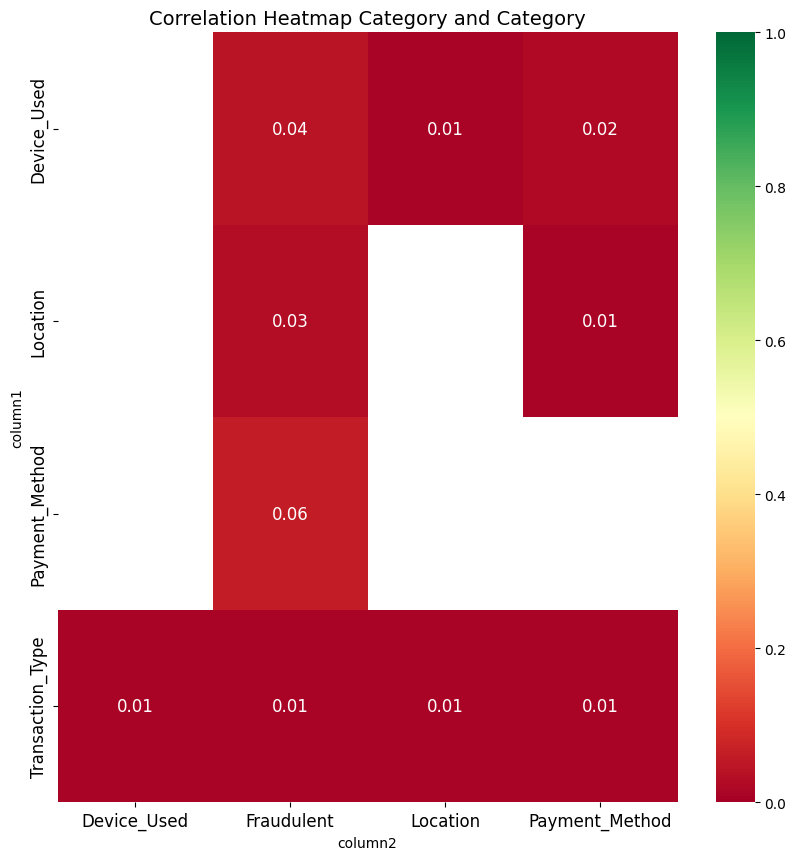

In [ ]:
df_temp_1 = df_corr_cat_cat_1.pivot_table(
  index='column1',
  columns='column2',
  values='coef',
)

for column1 in df_corr_cat_cat_1['column1']:
  for column2 in df_corr_cat_cat_1['column2']:
    if np.isnan(df_temp_1.loc[column1, column2]) and column1 < column2:
      df_temp_1.loc[column1, column2] = df_temp_1.loc[column2, column1]
      df_temp_1.loc[column2, column1] = None

plt.figure(figsize=(10, 10))
sns.heatmap(
  df_temp_1,
  vmin = 0,
  vmax = 1,
  cmap = 'RdYlGn',
  fmt=".2f",
  annot=True,
  annot_kws={"fontsize": 12}
)
plt.xticks(fontsize=12)  # <<< perbesar label sumbu X
plt.yticks(fontsize=12)  # <<< perbesar label sumbu Y
plt.title('Correlation Heatmap Category and Category', fontsize=14)
plt.show()

3. From the location, is there a far difference for each location of fraud ?

In [ ]:
df_location = df.copy()
df_location_1 = df_location[df_location['Fraudulent'] == 1]
df_location_1.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
6,T7,4772,544.81,Bill Payment,2.0,Tablet,Boston,3,6,9,UPI,1
27,T28,3433,4519.04,Bill Payment,13.0,Tablet,Boston,0,81,10,Credit Card,1
43,T44,3047,4413.05,Bank Transfer,21.0,Desktop,Boston,4,46,11,Credit Card,1
68,T69,3363,3517.65,Bill Payment,0.0,Desktop,Boston,2,29,8,UPI,1
73,T74,4417,1440.79,Online Purchase,15.0,Tablet,Miami,2,16,1,Net Banking,1


In [ ]:
df_location_2 = pd.pivot_table(
    data = df_location_1,
    index = 'Location',
    values = 'Fraudulent',
    aggfunc = 'sum'
).reset_index()#.sort_values(by = 'Location', ascending = True)
df_location_2

,Location,Fraudulent
0,Boston,424
1,Chicago,329
2,Houston,277
3,Los Angeles,305
4,Miami,293
5,New York,285
6,San Francisco,294
7,Seattle,260


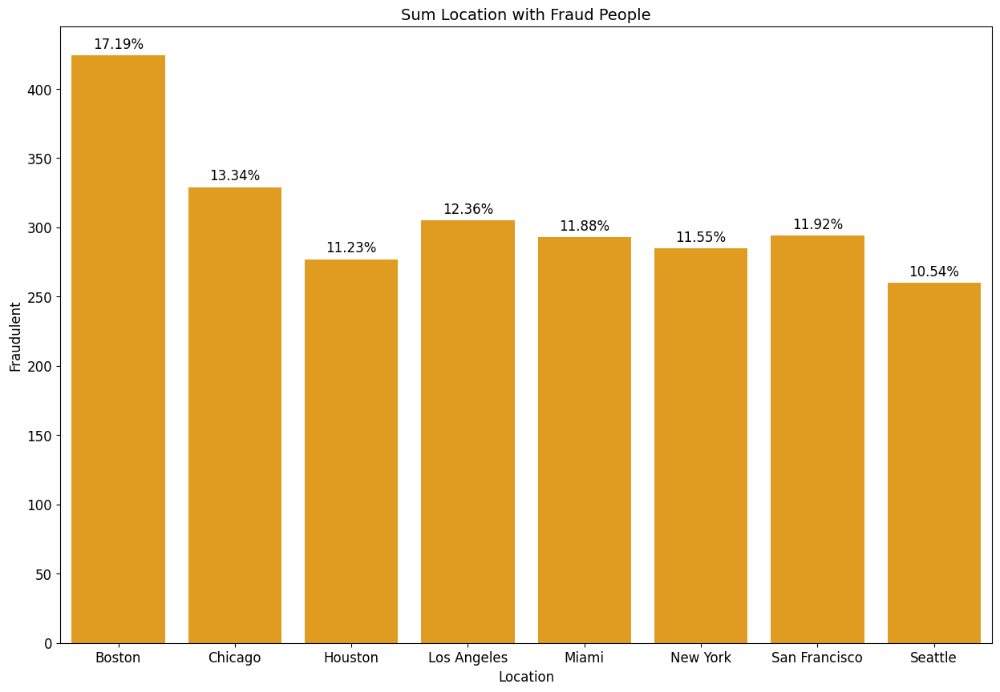

In [ ]:
# Create the bar chart with sorted values
# plt.style.use('dark_background')

plt.figure(figsize=(15, 10))

total_fraud_1 = df_location_2['Fraudulent'].sum()

ax = sns.barplot(data=df_location_2, x='Location', y='Fraudulent', color='orange')

# Set the title and labels
plt.title('Sum Location with Fraud People', fontsize = 14)
plt.xlabel('Location', fontsize = 12)
plt.ylabel('Fraudulent', fontsize = 12)

# Ukuran label axis
plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
#plt.xticks(rotation=45, horizontalalignment='right')

# Set the background color to grey
#plt.gca().set_facecolor('grey')

# Add count labels to the bars

for p in ax.patches:
    height = p.get_height()
    percent = (height / total_fraud_1) * 100
    if height > 0:
        ax.annotate(
            f'{percent:.2f}%',
            xy=(p.get_x() + p.get_width() / 2, height),
            ha='center', va='center',
            xytext=(0, 10),
            textcoords='offset points',
            color='black',
            fontsize = 12
        )

4. How was the distribution of customer age with fraud ? is it more higher or low to get fraud ?

In [ ]:
df_age = df.copy()
df_age_1 = df_age[df_age['Fraudulent'] == 1]
df_age_1.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
6,T7,4772,544.81,Bill Payment,2.0,Tablet,Boston,3,6,9,UPI,1
27,T28,3433,4519.04,Bill Payment,13.0,Tablet,Boston,0,81,10,Credit Card,1
43,T44,3047,4413.05,Bank Transfer,21.0,Desktop,Boston,4,46,11,Credit Card,1
68,T69,3363,3517.65,Bill Payment,0.0,Desktop,Boston,2,29,8,UPI,1
73,T74,4417,1440.79,Online Purchase,15.0,Tablet,Miami,2,16,1,Net Banking,1


In [ ]:
df_age_2 = pd.pivot_table(
    data = df_age_1,
    index = 'Account_Age',
    values = 'Fraudulent',
    aggfunc = 'sum'
).reset_index().sort_values(by = 'Account_Age')
df_age_2

,Account_Age,Fraudulent
0,1,20
1,2,28
2,3,29
3,4,20
4,5,14
5,6,19
6,7,21
7,8,22
8,9,24
9,10,27


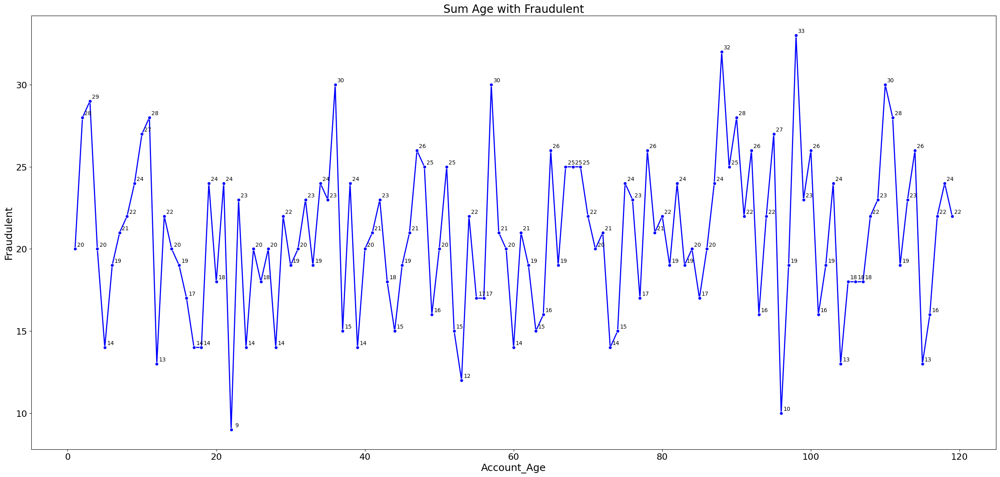

In [ ]:
# Visualisasi lineplot
plt.figure(figsize=(25, 12))
sns.lineplot(data=df_age_2, x='Account_Age', y="Fraudulent", marker="o", color="blue", linewidth=2)

# Menambahkan angka di setiap titik (Opsional)
for x, y in zip(df_age_2['Account_Age'], df_age_2['Fraudulent']):
    plt.annotate(format(y, '.0f'), xy=(x, y), textcoords="offset points", xytext=(10, 5), ha='center', color='black', fontsize=10)

# Menambahkan judul dan label
plt.title("Sum Age with Fraudulent", fontsize=20)
plt.xlabel("Account_Age", fontsize=18)
plt.ylabel("Fraudulent", fontsize=18)


# Ukuran angka di sumbu
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
#plt.xticks(rotation=45)

plt.tight_layout()  # Menghindari elemen terpotong
plt.show()

# Feature Engineering

In [ ]:
df.head()

,Transaction_ID,User_ID,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,T1,4174,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,T2,4507,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,T3,1860,2395.02,ATM Withdrawal,12.0,Mobile,Boston,3,115,9,UPI,0
3,T4,2294,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,T5,2130,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
df_fraud = df.drop(['User_ID'], axis = 1)
df_fraud = df_fraud.drop(['Transaction_ID'], axis = 1)
#df_bank_1['attrition_flag'] = df_bank_1['attrition_flag'].replace({'Attrited Customer': 1, 'Existing Customer': 0})
df_fraud.head()

,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method,Fraudulent
0,1292.76,ATM Withdrawal,16.0,Tablet,San Francisco,0,119,13,Debit Card,0
1,1554.58,ATM Withdrawal,13.0,Mobile,New York,4,79,3,Credit Card,0
2,2395.02,ATM Withdrawal,12.0,Mobile,Boston,3,115,9,UPI,0
3,100.10,Bill Payment,15.0,Desktop,Chicago,4,3,4,UPI,0
4,1490.50,POS Payment,19.0,Mobile,San Francisco,2,57,7,Credit Card,0


In [ ]:
df_fraud.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50119 entries, 0 to 50999
Data columns (total 10 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Transaction_Amount                50119 non-null  float64
 1   Transaction_Type                  50119 non-null  object 
 2   Time_of_Transaction               50119 non-null  float64
 3   Device_Used                       50119 non-null  object 
 4   Location                          50119 non-null  object 
 5   Previous_Fraudulent_Transactions  50119 non-null  int64  
 6   Account_Age                       50119 non-null  int64  
 7   Number_of_Transactions_Last_24H   50119 non-null  int64  
 8   Payment_Method                    50119 non-null  object 
 9   Fraudulent                        50119 non-null  int64  
dtypes: float64(2), int64(4), object(4)
memory usage: 4.2+ MB


In [ ]:
df_fraud.groupby('Fraudulent').size()

,0
Fraudulent,
0,47652
1,2467


Not Balanced

In [ ]:
# import scipy for certain statistical function
from scipy import stats

# import train and test split method from scikit-learn
from sklearn.model_selection import train_test_split
# import metrics method for model evaluation
import sklearn.metrics as metrics
# import random forest classifier
from sklearn.ensemble import RandomForestClassifier
# import multi-layer perceptron
from sklearn.neural_network import MLPClassifier
# import decision tree model as surrogate model
from sklearn.tree import DecisionTreeClassifier
# import tree module
from sklearn import tree

# import xgboost classifier
from xgboost import XGBClassifier

# import dalex to explain complex model
import dalex as dx

# load scikit-plot modules
import scikitplot as skplt

# load shap package for shap explanation
import shap

# load LimeTabularExplainer for LIME method
from lime.lime_tabular import LimeTabularExplainer

In [ ]:
# cretate predictor variables as X
X = df_fraud.drop(['Fraudulent'], axis = 1)
# create target data as y
y = df_fraud['Fraudulent']

In [ ]:
# split data to train and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify = y, random_state= 42) #stratify = y, random_state= 42)

In [ ]:
y_train.value_counts()

,count
Fraudulent,
0,38121
1,1974


## A. Train

In [ ]:
X_train.head()

,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method
32612,2763.27,Bill Payment,21.0,Mobile,San Francisco,4,38,4,UPI
9426,989.66,Online Purchase,20.0,Mobile,Seattle,2,51,9,UPI
28171,4813.30,Bill Payment,14.0,Desktop,Boston,2,115,5,UPI
826,4076.02,ATM Withdrawal,11.0,Mobile,Los Angeles,1,16,9,Net Banking
24189,2523.58,ATM Withdrawal,18.0,Tablet,Miami,2,84,9,Debit Card


### A.1 Multicolinarity

In [ ]:
kolom_baru = X_train.select_dtypes(include='number').columns.tolist()
kolom_baru

['Transaction_Amount',
 'Time_of_Transaction',
 'Previous_Fraudulent_Transactions',
 'Account_Age',
 'Number_of_Transactions_Last_24H']

In [ ]:
# calculate VIF scores
from statsmodels.stats.outliers_influence import variance_inflation_factor as vif
from statsmodels.tools.tools import add_constant

X = add_constant(X_train[kolom_baru])

vif_df = pd.DataFrame([vif(X.values, i)
               for i in range(X.shape[1])],
              index=X.columns).reset_index()
vif_df.columns = ['feature','vif_score']
vif_df = vif_df.loc[vif_df.feature!='const']
vif_df

,feature,vif_score
1,Transaction_Amount,1.000073
2,Time_of_Transaction,1.000205
3,Previous_Fraudulent_Transactions,1.000053
4,Account_Age,1.000116
5,Number_of_Transactions_Last_24H,1.000105


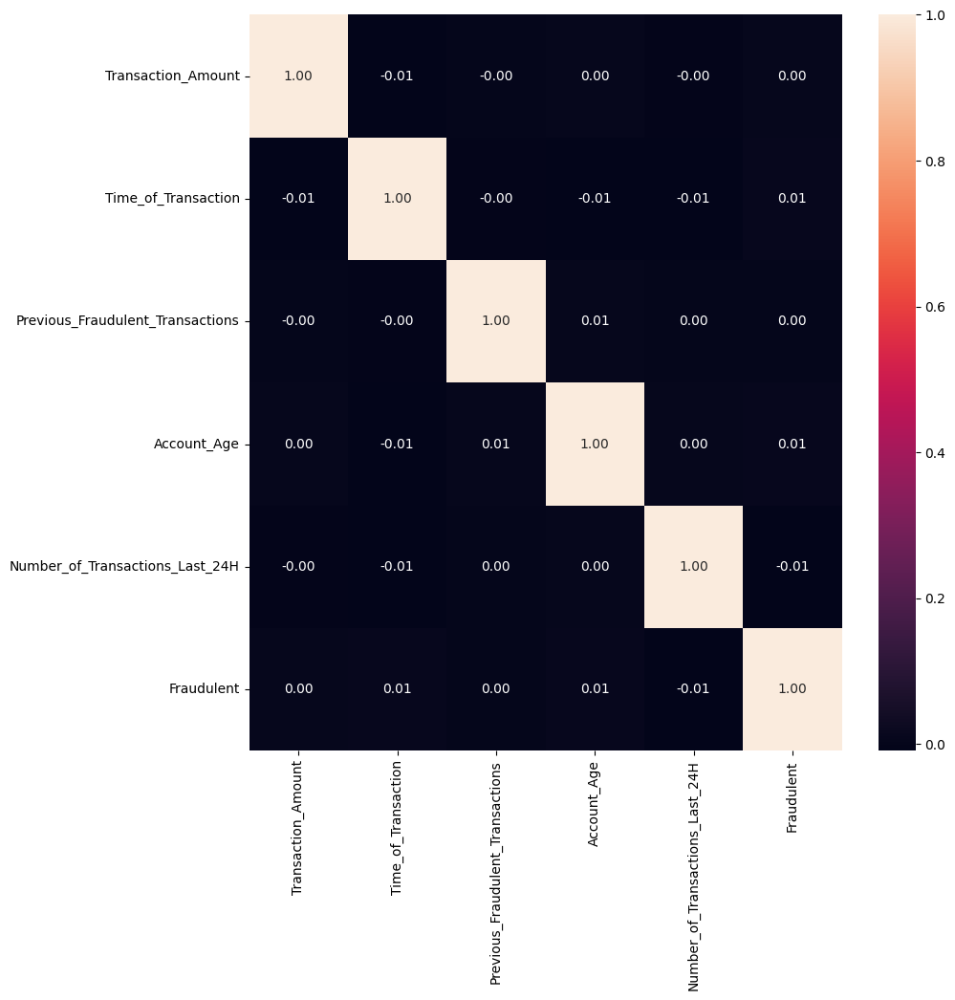

In [ ]:
# heatmap correlation
admit_train = pd.concat([X_train[kolom_baru], y_train], axis=1)
corr = admit_train.corr()

plt.figure(figsize=(10,10))
sns.heatmap(corr, annot=True, fmt='.2f')
plt.show()

Based on the multicolinarity, i think this feature is still normal (not overpowering for each column on it)

### A.2 Encoding

#### A.2.1 One Hot Encoding

In [ ]:
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.preprocessing import (
  LabelEncoder,
  MinMaxScaler,
  OneHotEncoder,
  OrdinalEncoder,
)
from sklearn.compose import ColumnTransformer

In [ ]:
categorical_columns = X_train.select_dtypes(include=['object']).columns.tolist()

encoder = OneHotEncoder(sparse_output = False, handle_unknown="ignore")

one_hot_encoded = encoder.fit_transform(X_train[categorical_columns])

df_encoded = pd.DataFrame(one_hot_encoded, columns=encoder.get_feature_names_out(categorical_columns))
df_encoded.index = X_train.index

df_encoded = pd.concat([X_train, df_encoded], axis=1)

X_train = df_encoded.drop(columns = categorical_columns)
X_train.head()
#print(f"Encoded Employee data : \n{df_encoded}")

,Transaction_Amount,Time_of_Transaction,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Transaction_Type_ATM Withdrawal,Transaction_Type_Bank Transfer,Transaction_Type_Bill Payment,Transaction_Type_Online Purchase,Transaction_Type_POS Payment,Device_Used_Desktop,Device_Used_Mobile,Device_Used_Tablet,Location_Boston,Location_Chicago,Location_Houston,Location_Los Angeles,Location_Miami,Location_New York,Location_San Francisco,Location_Seattle,Payment_Method_Credit Card,Payment_Method_Debit Card,Payment_Method_Invalid Method,Payment_Method_Net Banking,Payment_Method_UPI
32612,2763.27,21.0,4,38,4,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
9426,989.66,20.0,2,51,9,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
28171,4813.30,14.0,2,115,5,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
826,4076.02,11.0,1,16,9,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
24189,2523.58,18.0,2,84,9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


### A.3 Imbalanced Data Handling

In [ ]:
from imblearn import over_sampling, under_sampling

# Overampling with RandomOverSampler
X_over_smote, y_over_smote = under_sampling.RandomUnderSampler().fit_resample(X_train, y_train)

In [ ]:
from imblearn import over_sampling, under_sampling

# Overampling with RandomOverSampler
X_over_smote_1, y_over_smote_1 = over_sampling.RandomOverSampler().fit_resample(X_train, y_train)

In [ ]:
from imblearn import over_sampling

# Overampling with smote
X_over_smote_2, y_over_smote_2 = over_sampling.SMOTE().fit_resample(X_train, y_train)

In [ ]:
X_over_smote.head()

,Transaction_Amount,Time_of_Transaction,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Transaction_Type_ATM Withdrawal,Transaction_Type_Bank Transfer,Transaction_Type_Bill Payment,Transaction_Type_Online Purchase,Transaction_Type_POS Payment,Device_Used_Desktop,Device_Used_Mobile,Device_Used_Tablet,Location_Boston,Location_Chicago,Location_Houston,Location_Los Angeles,Location_Miami,Location_New York,Location_San Francisco,Location_Seattle,Payment_Method_Credit Card,Payment_Method_Debit Card,Payment_Method_Invalid Method,Payment_Method_Net Banking,Payment_Method_UPI
14541,130.41,2.0,3,78,3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
11591,353.21,2.0,0,108,10,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
21408,631.90,16.0,1,91,12,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
42891,4211.04,10.0,2,68,2,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
38011,1161.43,5.0,4,62,5,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
y_over_smote.value_counts()

,count
Fraudulent,
0,1974
1,1974


In [ ]:
# split data to train and test data
X_train_1, X_val, y_train_1, y_val = train_test_split(X_over_smote, y_over_smote, test_size=0.2, stratify = y_over_smote, random_state= 42)

In [ ]:
y_train_1.value_counts()

,count
Fraudulent,
0,1579
1,1579


## B. Test

In [ ]:
X_test.head()

,Transaction_Amount,Transaction_Type,Time_of_Transaction,Device_Used,Location,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Payment_Method
20927,1747.68,POS Payment,9.0,Desktop,Miami,3,29,13,Invalid Method
39055,233.20,Online Purchase,10.0,Desktop,Los Angeles,3,60,2,UPI
26671,1602.11,ATM Withdrawal,14.0,Desktop,Boston,2,28,10,Net Banking
21890,254.71,ATM Withdrawal,8.0,Mobile,Miami,2,40,7,Net Banking
26525,4998.80,POS Payment,7.0,Tablet,New York,1,13,11,Credit Card


### B.1 Encoding

#### B.1.1 One Hot Encoding

In [ ]:
#categorical_columns = X_test.select_dtypes(include=['object']).columns.tolist()

#encoder = OneHotEncoder(sparse_output=False)

one_hot_encoded_1 = encoder.transform(X_test[categorical_columns])

df_encoded = pd.DataFrame(one_hot_encoded_1, columns=encoder.get_feature_names_out(categorical_columns))
df_encoded.index = X_test.index

df_encoded = pd.concat([X_test, df_encoded], axis=1)

X_test = df_encoded.drop(columns = categorical_columns)
X_test.head()

,Transaction_Amount,Time_of_Transaction,Previous_Fraudulent_Transactions,Account_Age,Number_of_Transactions_Last_24H,Transaction_Type_ATM Withdrawal,Transaction_Type_Bank Transfer,Transaction_Type_Bill Payment,Transaction_Type_Online Purchase,Transaction_Type_POS Payment,Device_Used_Desktop,Device_Used_Mobile,Device_Used_Tablet,Location_Boston,Location_Chicago,Location_Houston,Location_Los Angeles,Location_Miami,Location_New York,Location_San Francisco,Location_Seattle,Payment_Method_Credit Card,Payment_Method_Debit Card,Payment_Method_Invalid Method,Payment_Method_Net Banking,Payment_Method_UPI
20927,1747.68,9.0,3,29,13,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
39055,233.20,10.0,3,60,2,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
26671,1602.11,14.0,2,28,10,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
21890,254.71,8.0,2,40,7,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
26525,4998.80,7.0,1,13,11,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


## C. Scalling

In [ ]:
scaler_transaction = MinMaxScaler()
X_train_1['Transaction_Amount'] = scaler_transaction.fit_transform(X_train_1[['Transaction_Amount']])
X_test['Transaction_Amount'] = scaler_transaction.transform(X_test[['Transaction_Amount']])

scaler_transaction.inverse_transform([[1]])

array([[49997.8]])

In [ ]:
scaler_time = MinMaxScaler()
X_train_1['Time_of_Transaction'] = scaler_time.fit_transform(X_train_1[['Time_of_Transaction']])
X_test['Time_of_Transaction'] = scaler_time.transform(X_test[['Time_of_Transaction']])

scaler_time.inverse_transform([[1]])

array([[23.]])

In [ ]:
scaler_previous = MinMaxScaler()
X_train_1['Previous_Fraudulent_Transactions'] = scaler_previous.fit_transform(X_train_1[['Previous_Fraudulent_Transactions']])
X_test['Previous_Fraudulent_Transactions'] = scaler_previous.transform(X_test[['Previous_Fraudulent_Transactions']])

scaler_previous.inverse_transform([[1]])

array([[4.]])

In [ ]:
scaler_account = MinMaxScaler()
X_train_1['Account_Age'] = scaler_account.fit_transform(X_train_1[['Account_Age']])
X_test['Account_Age'] = scaler_account.transform(X_test[['Account_Age']])

scaler_account.inverse_transform([[1]])

array([[119.]])

In [ ]:
scaler_number = MinMaxScaler()
X_train_1['Number_of_Transactions_Last_24H'] = scaler_number.fit_transform(X_train_1[['Number_of_Transactions_Last_24H']])
X_test['Number_of_Transactions_Last_24H'] = scaler_number.transform(X_test[['Number_of_Transactions_Last_24H']])

scaler_number.inverse_transform([[1]])

array([[14.]])

# Modelling

## A. Logistic Regression

In [ ]:
# A. Logistic Regression (Baseline Model)
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# GridSearchCV for tuning parameter
logreg = LogisticRegression(random_state=42)
param_lr = {
    'C': [0.1, 1, 10, 100, 0.01],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear']
}

logreg_gridcv = GridSearchCV(logreg, param_lr, cv=5, scoring='recall')
logreg_gridcv.fit(X_train_1, y_train_1)

GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42),
             param_grid={'C': [0.1, 1, 10, 100, 0.01], 'penalty': ['l1', 'l2'],
                         'solver': ['liblinear']},
             scoring='recall')

In [ ]:
# Tuning results
cv_lr = pd.DataFrame(logreg_gridcv.cv_results_)[['params', 'mean_test_score', 'rank_test_score']] \
            .sort_values('rank_test_score') \
            .reset_index(drop=True)

print("=== Logistic Regression CV Results ===")
cv_lr.head(5)

=== Logistic Regression CV Results ===


,params,mean_test_score,rank_test_score
0,"{'C': 0.1, 'penalty': 'l1', 'solver': 'libline...",0.533257,1
1,"{'C': 0.01, 'penalty': 'l2', 'solver': 'liblin...",0.527561,2
2,"{'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}",0.522477,3
3,"{'C': 0.1, 'penalty': 'l2', 'solver': 'libline...",0.520569,4
4,"{'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}",0.518033,5


In [ ]:
best_logreg = logreg_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_logreg_test = best_logreg.predict(X_test)
y_pred_logreg_train = best_logreg.predict(X_train_1)
y_prob_logreg_train = best_logreg.predict_proba(X_train_1)[:,1]
y_prob_logreg_test = best_logreg.predict_proba(X_test)[:,1]

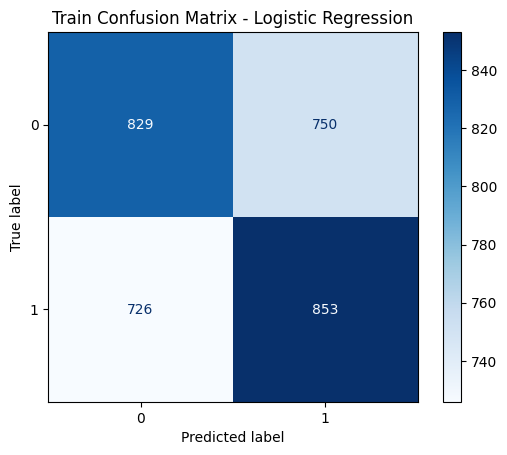

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_train_lr = confusion_matrix(y_train_1, y_pred_logreg_train)
disp_train = ConfusionMatrixDisplay(cm_train_lr, display_labels=best_logreg.classes_)
disp_train.plot(cmap='Blues')
plt.title("Train Confusion Matrix - Logistic Regression")
plt.show()

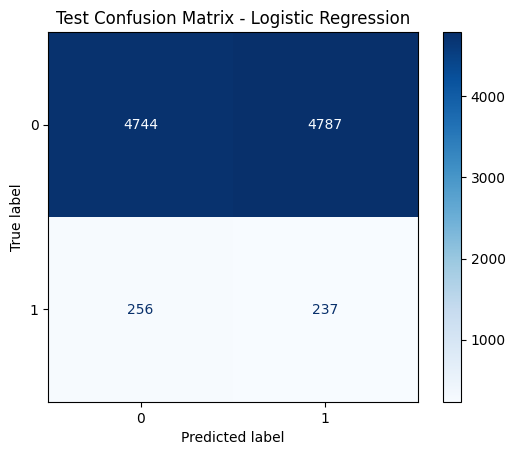

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_test_lr = confusion_matrix(y_test, y_pred_logreg_test)
disp_test = ConfusionMatrixDisplay(cm_test_lr, display_labels=best_logreg.classes_)
disp_test.plot(cmap='Blues')
plt.title("Test Confusion Matrix - Logistic Regression")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_logreg_train))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.53      0.53      0.53      1579
           1       0.53      0.54      0.54      1579

    accuracy                           0.53      3158
   macro avg       0.53      0.53      0.53      3158
weighted avg       0.53      0.53      0.53      3158



In [ ]:
print("=== Classification Report: TEST ===")
print(classification_report(y_test, y_pred_logreg_test))

=== Classification Report: TEST ===
              precision    recall  f1-score   support

           0       0.95      0.50      0.65      9531
           1       0.05      0.48      0.09       493

    accuracy                           0.50     10024
   macro avg       0.50      0.49      0.37     10024
weighted avg       0.90      0.50      0.63     10024



In [ ]:
# === ROC Curve ===
fpr_tr, tpr_tr, _ = roc_curve(y_train_1, y_prob_logreg_train)
fpr_te, tpr_te, _ = roc_curve(y_test, y_prob_logreg_test)
auc_tr = auc(fpr_tr, tpr_tr)
auc_te = auc(fpr_te, tpr_te)

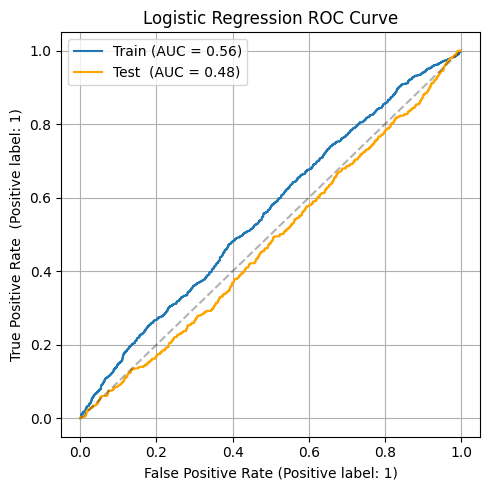

In [ ]:
plt.figure(figsize=(5,5))
plt.plot(fpr_tr, tpr_tr, label=f"Train (AUC = {auc_tr:.2f})")
plt.plot(fpr_te, tpr_te, label=f"Test  (AUC = {auc_te:.2f})", color='orange')
plt.plot([0,1],[0,1],'k--', alpha=0.3)
plt.xlabel("False Positive Rate (Positive label: 1)")
plt.ylabel("True Positive Rate  (Positive label: 1)")
plt.title("Logistic Regression ROC Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

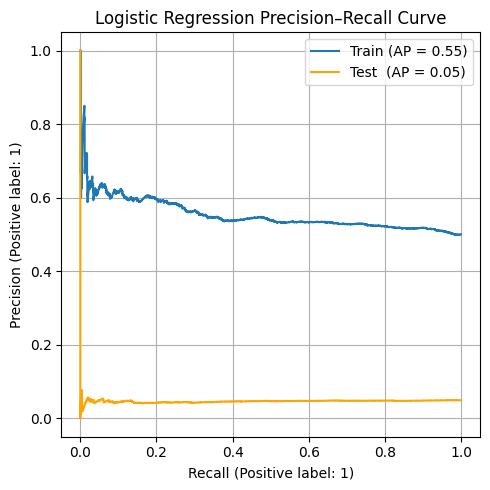

In [ ]:
# === Precision–Recall Curve ===
prec_tr, rec_tr, _ = precision_recall_curve(y_train_1,y_prob_logreg_train)
prec_te, rec_te, _ = precision_recall_curve(y_test,  y_prob_logreg_test)
ap_tr = average_precision_score(y_train_1, y_prob_logreg_train)
ap_te = average_precision_score(y_test,  y_prob_logreg_test)

plt.figure(figsize=(5,5))
plt.plot(rec_tr, prec_tr, label=f"Train (AP = {ap_tr:.2f})")
plt.plot(rec_te, prec_te, label=f"Test  (AP = {ap_te:.2f})", color='orange')
plt.xlabel("Recall (Positive label: 1)")
plt.ylabel("Precision (Positive label: 1)")
plt.title("Logistic Regression Precision–Recall Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## KNN

In [ ]:
# B. KNN Classifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# Hyperparameter tuning with GridSearchCV
knn = KNeighborsClassifier()
param_knn = {
    'n_neighbors': [3, 5, 9, 7],
    'weights': ['uniform', 'distance']
}

gs_knn = GridSearchCV(knn, param_knn, cv=5, scoring='recall')
gs_knn.fit(X_train_1, y_train_1)
#best_knn = gs_knn.best_estimator_

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [3, 5, 9, 7],
                         'weights': ['uniform', 'distance']},
             scoring='recall')

In [ ]:
# View CV results
cv_knn = pd.DataFrame(gs_knn.cv_results_)[['params', 'mean_test_score', 'rank_test_score']] \
            .sort_values('rank_test_score') \
            .reset_index(drop=True)

print("=== KNN CV Results ===")
cv_knn.head(5)

=== KNN CV Results ===


,params,mean_test_score,rank_test_score
0,"{'n_neighbors': 7, 'weights': 'distance'}",0.500358,1
1,"{'n_neighbors': 3, 'weights': 'uniform'}",0.498431,2
2,"{'n_neighbors': 5, 'weights': 'distance'}",0.497808,3
3,"{'n_neighbors': 7, 'weights': 'uniform'}",0.493998,4
4,"{'n_neighbors': 3, 'weights': 'distance'}",0.493998,5


In [ ]:
best_knn = gs_knn.best_estimator_

In [ ]:
# Predictions
y_pred_train_knn = best_knn.predict(X_train_1)
y_pred_test_knn  = best_knn.predict(X_test)
y_prob_train_knn = best_knn.predict_proba(X_train_1)[:, 1]
y_prob_test_knn  = best_knn.predict_proba(X_test)[:, 1]

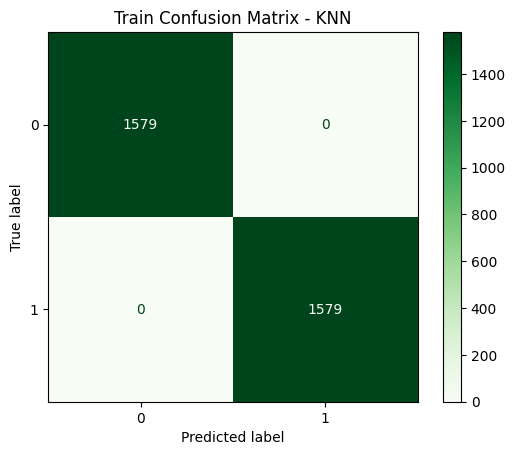

In [ ]:
# Confusion Matrix - TRAIN
cm_train_knn = confusion_matrix(y_train_1, y_pred_train_knn)
disp_train_1 = ConfusionMatrixDisplay(cm_train_knn, display_labels=best_knn.classes_)
disp_train_1.plot(cmap='Greens')
plt.title("Train Confusion Matrix - KNN")
plt.show()

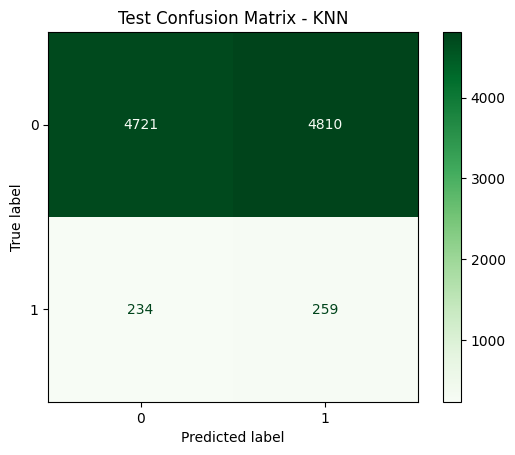

In [ ]:
# Confusion Matrix - TEST
cm_test_knn = confusion_matrix(y_test, y_pred_test_knn)
disp_test_1 = ConfusionMatrixDisplay(cm_test_knn, display_labels=best_knn.classes_)
disp_test_1.plot(cmap='Greens')
plt.title("Test Confusion Matrix - KNN")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_train_knn))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1579
           1       1.00      1.00      1.00      1579

    accuracy                           1.00      3158
   macro avg       1.00      1.00      1.00      3158
weighted avg       1.00      1.00      1.00      3158



In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_test, y_pred_test_knn))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.95      0.50      0.65      9531
           1       0.05      0.53      0.09       493

    accuracy                           0.50     10024
   macro avg       0.50      0.51      0.37     10024
weighted avg       0.91      0.50      0.62     10024



## Decision Tree

In [ ]:
# Import Library
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)

In [ ]:
# GridSearchCV for tuning parameter
dt = DecisionTreeClassifier(random_state=42)
param_dt = {
    'max_depth': [None, 3, 5, 7],
    'min_samples_leaf': [1, 5, 10]
}

dt_gridcv = GridSearchCV(dt, param_dt, cv=5, scoring='recall')
dt_gridcv.fit(X_train_1, y_train_1)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [None, 3, 5, 7],
                         'min_samples_leaf': [1, 5, 10]},
             scoring='recall')

In [ ]:
# View CV results
cv_dt = pd.DataFrame(dt_gridcv.cv_results_)[['params', 'mean_test_score', 'rank_test_score']] \
            .sort_values('rank_test_score') \
            .reset_index(drop=True)

print("=== Decission Tree CV Results ===")
cv_dt.head(5)

=== Decission Tree CV Results ===


,params,mean_test_score,rank_test_score
0,"{'max_depth': 5, 'min_samples_leaf': 1}",0.581404,1
1,"{'max_depth': 7, 'min_samples_leaf': 1}",0.554736,2
2,"{'max_depth': 5, 'min_samples_leaf': 5}",0.541531,3
3,"{'max_depth': 5, 'min_samples_leaf': 10}",0.521276,4
4,"{'max_depth': 7, 'min_samples_leaf': 5}",0.517384,5


In [ ]:
best_dt = dt_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_train_dt = best_dt.predict(X_train_1)
y_pred_test_dt  = best_dt.predict(X_test)
y_prob_train_dt = best_dt.predict_proba(X_train_1)[:, 1]
y_prob_test_dt  = best_dt.predict_proba(X_test)[:, 1]

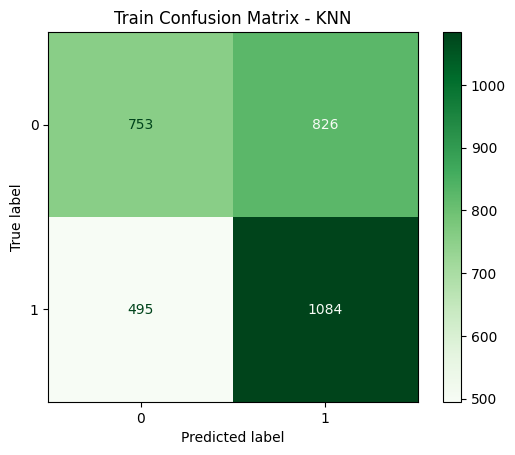

In [ ]:
# Confusion Matrix - TRAIN
cm_train_dt = confusion_matrix(y_train_1, y_pred_train_dt)
disp_train_2 = ConfusionMatrixDisplay(cm_train_dt, display_labels=best_dt.classes_)
disp_train_2.plot(cmap='Greens')
plt.title("Train Confusion Matrix - KNN")
plt.show()

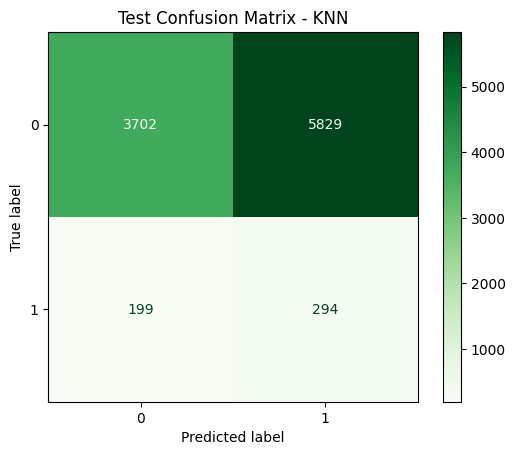

In [ ]:
# Confusion Matrix - TEST
cm_test_dt = confusion_matrix(y_test, y_pred_test_dt)
disp_test_2 = ConfusionMatrixDisplay(cm_test_dt, display_labels=best_dt.classes_)
disp_test_2.plot(cmap='Greens')
plt.title("Test Confusion Matrix - KNN")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_train_dt))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.60      0.48      0.53      1579
           1       0.57      0.69      0.62      1579

    accuracy                           0.58      3158
   macro avg       0.59      0.58      0.58      3158
weighted avg       0.59      0.58      0.58      3158



In [ ]:
# === Classification Report ===
print("=== Classification Report: TEST ===")
print(classification_report(y_test, y_pred_test_dt))

=== Classification Report: TEST ===
              precision    recall  f1-score   support

           0       0.95      0.39      0.55      9531
           1       0.05      0.60      0.09       493

    accuracy                           0.40     10024
   macro avg       0.50      0.49      0.32     10024
weighted avg       0.90      0.40      0.53     10024



In [ ]:
# === ROC Curve ===
fpr_tr_1, tpr_tr_1, _ = roc_curve(y_train_1, y_prob_train_dt)
fpr_te_1, tpr_te_1, _ = roc_curve(y_test,  y_prob_test_dt)
auc_tr_1 = auc(fpr_tr_1, tpr_tr_1)
auc_te_1 = auc(fpr_te_1, tpr_te_1)

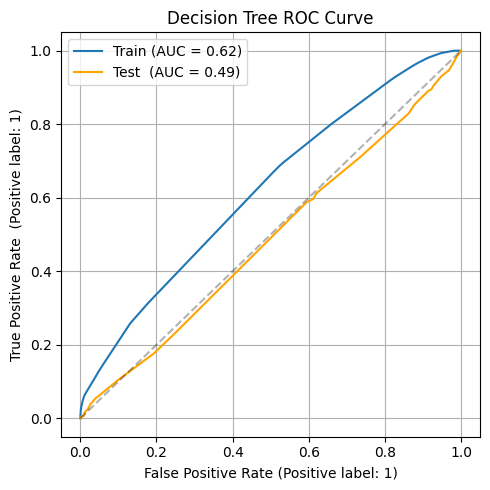

In [ ]:
plt.figure(figsize=(5,5))
plt.plot(fpr_tr_1, tpr_tr_1, label=f"Train (AUC = {auc_tr_1:.2f})")
plt.plot(fpr_te_1, tpr_te_1, label=f"Test  (AUC = {auc_te_1:.2f})", color='orange')
plt.plot([0,1],[0,1],'k--', alpha=0.3)
plt.xlabel("False Positive Rate (Positive label: 1)")
plt.ylabel("True Positive Rate  (Positive label: 1)")
plt.title("Decision Tree ROC Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

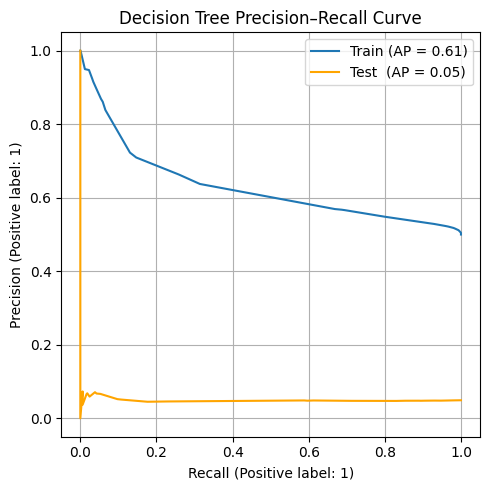

In [ ]:
# === Precision–Recall Curve ===
prec_tr_1, rec_tr_1, _ = precision_recall_curve(y_train_1,y_prob_train_dt)
prec_te_1, rec_te_1, _ = precision_recall_curve(y_test,  y_prob_test_dt)
ap_tr_1 = average_precision_score(y_train_1, y_prob_train_dt)
ap_te_1 = average_precision_score(y_test,  y_prob_test_dt)

plt.figure(figsize=(5,5))
plt.plot(rec_tr_1, prec_tr_1, label=f"Train (AP = {ap_tr_1:.2f})")
plt.plot(rec_te_1, prec_te_1, label=f"Test  (AP = {ap_te_1:.2f})", color='orange')
plt.xlabel("Recall (Positive label: 1)")
plt.ylabel("Precision (Positive label: 1)")
plt.title("Decision Tree Precision–Recall Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## B. Random Forest

In [ ]:
# define random forest classifier model
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(random_state=42)

In [ ]:
%%time
from sklearn.model_selection import GridSearchCV

parameters = {
    'n_estimators': [10,20,30,40,50],
    'max_depth':[1,2,3,4,5]
}

# note: we use recall
rf_clf_gridcv = GridSearchCV(rf_clf, parameters, cv=5, scoring='recall')
rf_clf_gridcv.fit(X_train_1, y_train_1)

CPU times: user 10.3 s, sys: 29.2 ms, total: 10.4 s
Wall time: 10.6 s


GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'max_depth': [1, 2, 3, 4, 5],
                         'n_estimators': [10, 20, 30, 40, 50]},
             scoring='recall')

In [ ]:
# the results
cv_result_1 = pd.DataFrame(rf_clf_gridcv.cv_results_)
retain_cols = ['params','mean_test_score','rank_test_score']
cv_result_1[retain_cols].sort_values('rank_test_score').head()

,params,mean_test_score,rank_test_score
0,"{'max_depth': 1, 'n_estimators': 10}",0.706048,1
5,"{'max_depth': 2, 'n_estimators': 10}",0.618013,2
10,"{'max_depth': 3, 'n_estimators': 10}",0.615507,3
1,"{'max_depth': 1, 'n_estimators': 20}",0.611013,4
3,"{'max_depth': 1, 'n_estimators': 40}",0.588853,5


In [ ]:
best_rf = rf_clf_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_rf_test = best_rf.predict(X_test)
y_pred_rf_train = best_rf.predict(X_train_1)
y_prob_rf_train = best_rf.predict_proba(X_train_1)[:,1]
y_prob_rf_test = best_rf.predict_proba(X_test)[:,1]

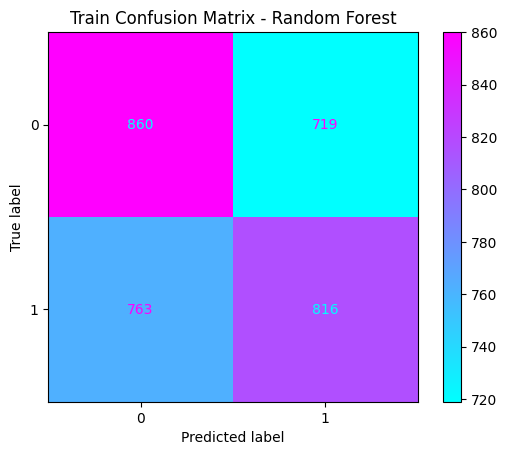

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_train_rf = confusion_matrix(y_train_1, y_pred_rf_train)
disp_train_3 = ConfusionMatrixDisplay(cm_train_rf, display_labels=best_rf.classes_)
disp_train_3.plot(cmap='cool')
plt.title("Train Confusion Matrix - Random Forest")
plt.show()

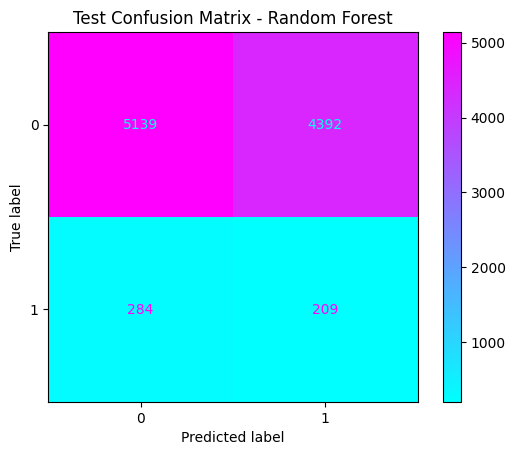

In [ ]:
# === Confusion Matrix - Test ===
cm_test_rf = confusion_matrix(y_test, y_pred_rf_test)
disp_test_3 = ConfusionMatrixDisplay(cm_test_rf, display_labels=best_rf.classes_)
disp_test_3.plot(cmap='cool')
plt.title("Test Confusion Matrix - Random Forest")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_rf_train))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.53      0.54      0.54      1579
           1       0.53      0.52      0.52      1579

    accuracy                           0.53      3158
   macro avg       0.53      0.53      0.53      3158
weighted avg       0.53      0.53      0.53      3158



In [ ]:
# === Classification Report ===
print("=== Classification Report: TEST ===")
print(classification_report(y_test, y_pred_rf_test))

=== Classification Report: TEST ===
              precision    recall  f1-score   support

           0       0.95      0.54      0.69      9531
           1       0.05      0.42      0.08       493

    accuracy                           0.53     10024
   macro avg       0.50      0.48      0.38     10024
weighted avg       0.90      0.53      0.66     10024



In [ ]:
# === ROC Curve ===
fpr_tr_2, tpr_tr_2, _ = roc_curve(y_train_1, y_prob_rf_train)
fpr_te_2, tpr_te_2, _ = roc_curve(y_test,  y_prob_rf_test)
auc_tr_2 = auc(fpr_tr_2, tpr_tr_2)
auc_te_2 = auc(fpr_te_2, tpr_te_2)

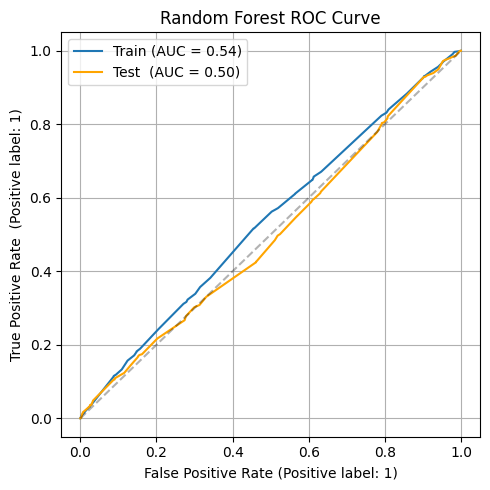

In [ ]:
plt.figure(figsize=(5,5))
plt.plot(fpr_tr_2, tpr_tr_2, label=f"Train (AUC = {auc_tr_2:.2f})")
plt.plot(fpr_te_2, tpr_te_2, label=f"Test  (AUC = {auc_te_2:.2f})", color='orange')
plt.plot([0,1],[0,1],'k--', alpha=0.3)
plt.xlabel("False Positive Rate (Positive label: 1)")
plt.ylabel("True Positive Rate  (Positive label: 1)")
plt.title("Random Forest ROC Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

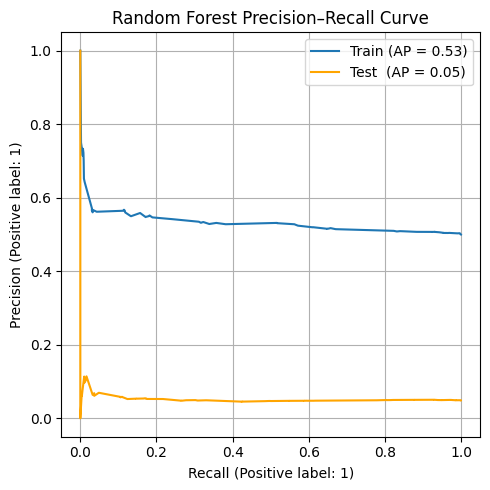

In [ ]:
# === Precision–Recall Curve ===
prec_tr_2, rec_tr_2, _ = precision_recall_curve(y_train_1,y_prob_rf_train)
prec_te_2, rec_te_2, _ = precision_recall_curve(y_test,  y_prob_rf_test)
ap_tr_2 = average_precision_score(y_train_1, y_prob_rf_train)
ap_te_2 = average_precision_score(y_test,  y_prob_rf_test)

plt.figure(figsize=(5,5))
plt.plot(rec_tr_2, prec_tr_2, label=f"Train (AP = {ap_tr_2:.2f})")
plt.plot(rec_te_2, prec_te_2, label=f"Test  (AP = {ap_te_2:.2f})", color='orange')
plt.xlabel("Recall (Positive label: 1)")
plt.ylabel("Precision (Positive label: 1)")
plt.title("Random Forest Precision–Recall Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## C. XGBoost

In [ ]:
scale_pos_weight = 1 - sum(y_train) / y_train.shape[0]
scale_pos_weight

0.9507669285447063

In [ ]:
from collections import Counter
counter = Counter(y_train)
print(counter)

Counter({0: 38121, 1: 1974})


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB # Gaussian Naive Bayes
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC # Support Vector Machine/Classifier
from sklearn.neural_network import MLPClassifier # Neural Network
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier
import lightgbm as lgb
from lightgbm import LGBMClassifier

from sklearn import metrics
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, fbeta_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.inspection import permutation_importance
import shap

from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from scipy.stats import uniform

import re
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# 3. Define model
xgb_clf = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state = 42)#, scale_pos_weight = 1 - sum(y_train) / y_train.shape[0])

# 4. Define parameter grid
param_grid_1 = {
    'n_estimators': [10, 50, 100],
    'max_depth': [2, 4, 6],
    'learning_rate': [0.01, 0.1, 0.2]
    #'scale_pos_weight': [17, 18, 19]
}

# note: we use recall
xgb_clf_gridcv = GridSearchCV(xgb_clf, param_grid_1, cv=5, scoring='recall')
xgb_clf_gridcv.fit(X_train_1, y_train_1)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='logloss', feature_types=None,
                                     feature_weights=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraint...
                                     learning_rate=None, max_bin=None,
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None, ...),
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [2, 4, 6],
                         'n_estimators': [10, 50, 100]},
             scoring='recall')

In [ ]:
# the results
cv_result_2 = pd.DataFrame(xgb_clf_gridcv.cv_results_)
retain_cols = ['params','mean_test_score','rank_test_score']
cv_result_2[retain_cols].sort_values('rank_test_score').head()

,params,mean_test_score,rank_test_score
1,"{'learning_rate': 0.01, 'max_depth': 2, 'n_est...",0.632021,1
0,"{'learning_rate': 0.01, 'max_depth': 2, 'n_est...",0.587434,2
3,"{'learning_rate': 0.01, 'max_depth': 4, 'n_est...",0.563621,3
14,"{'learning_rate': 0.1, 'max_depth': 4, 'n_esti...",0.550325,4
2,"{'learning_rate': 0.01, 'max_depth': 2, 'n_est...",0.545212,5


In [ ]:
best_xgb = xgb_clf_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_xgb_test = best_xgb.predict(X_test)
y_pred_xgb_train = best_xgb.predict(X_train_1)
y_prob_xgb_train = best_xgb.predict_proba(X_train_1)[:,1]
y_prob_xgb_test = best_xgb.predict_proba(X_test)[:,1]

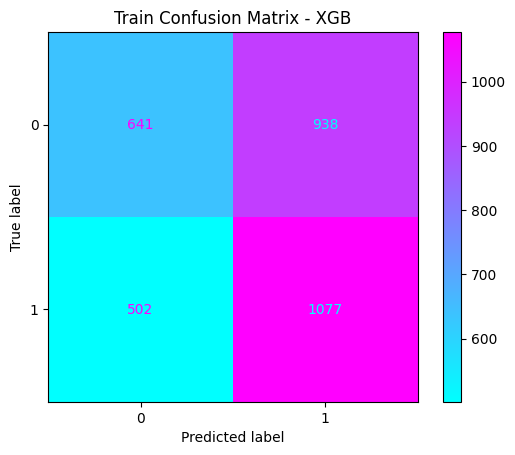

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_train_xgb = confusion_matrix(y_train_1, y_pred_xgb_train)
disp_train_4 = ConfusionMatrixDisplay(cm_train_xgb, display_labels=best_xgb.classes_)
disp_train_4.plot(cmap='cool')
plt.title("Train Confusion Matrix - XGB")
plt.show()

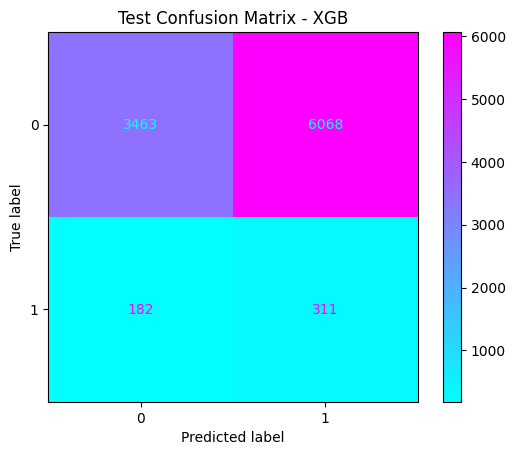

In [ ]:
# === Confusion Matrix - Test ===
cm_test_xgb = confusion_matrix(y_test, y_pred_xgb_test)
disp_train_4 = ConfusionMatrixDisplay(cm_test_xgb, display_labels=best_xgb.classes_)
disp_train_4.plot(cmap='cool')
plt.title("Test Confusion Matrix - XGB")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_xgb_train))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.56      0.41      0.47      1579
           1       0.53      0.68      0.60      1579

    accuracy                           0.54      3158
   macro avg       0.55      0.54      0.54      3158
weighted avg       0.55      0.54      0.54      3158



In [ ]:
# === Classification Report ===
print("=== Classification Report: TEST ===")
print(classification_report(y_test, y_pred_xgb_test))

=== Classification Report: TEST ===
              precision    recall  f1-score   support

           0       0.95      0.36      0.53      9531
           1       0.05      0.63      0.09       493

    accuracy                           0.38     10024
   macro avg       0.50      0.50      0.31     10024
weighted avg       0.91      0.38      0.50     10024



In [ ]:
# === ROC Curve ===
fpr_tr_3, tpr_tr_3, _ = roc_curve(y_train_1, y_prob_xgb_train)
fpr_te_3, tpr_te_3, _ = roc_curve(y_test,  y_prob_xgb_test)
auc_tr_3 = auc(fpr_tr_3, tpr_tr_3)
auc_te_3 = auc(fpr_te_3, tpr_te_3)

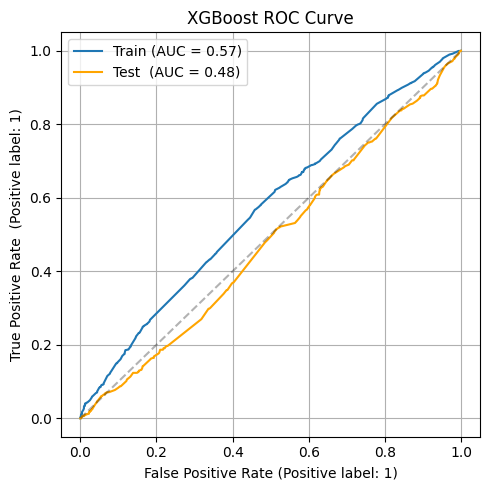

In [ ]:
plt.figure(figsize=(5,5))
plt.plot(fpr_tr_3, tpr_tr_3, label=f"Train (AUC = {auc_tr_3:.2f})")
plt.plot(fpr_te_3, tpr_te_3, label=f"Test  (AUC = {auc_te_3:.2f})", color='orange')
plt.plot([0,1],[0,1],'k--', alpha=0.3)
plt.xlabel("False Positive Rate (Positive label: 1)")
plt.ylabel("True Positive Rate  (Positive label: 1)")
plt.title("XGBoost ROC Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

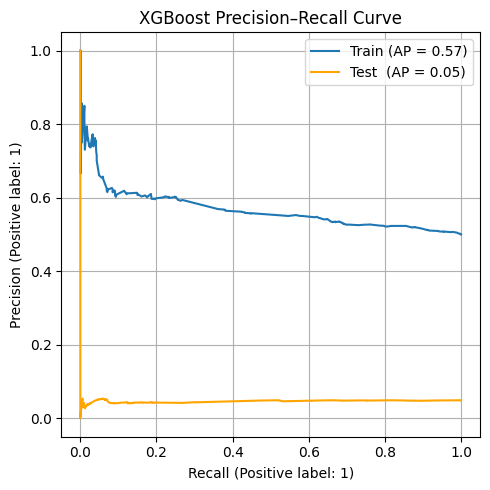

In [ ]:
# === Precision–Recall Curve ===
prec_tr_3, rec_tr_3, _ = precision_recall_curve(y_train_1,y_prob_xgb_train)
prec_te_3, rec_te_3, _ = precision_recall_curve(y_test,  y_prob_xgb_test)
ap_tr_3 = average_precision_score(y_train_1, y_prob_xgb_train)
ap_te_3 = average_precision_score(y_test,  y_prob_xgb_test)

plt.figure(figsize=(5,5))
plt.plot(rec_tr_3, prec_tr_3, label=f"Train (AP = {ap_tr_3:.2f})")
plt.plot(rec_te_3, prec_te_3, label=f"Test  (AP = {ap_te_3:.2f})", color='orange')
plt.xlabel("Recall (Positive label: 1)")
plt.ylabel("Precision (Positive label: 1)")
plt.title("XGBoost Precision–Recall Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## Gradient Boosed Tree Regressor

In [ ]:
# A. Logistic Regression (Baseline Model)
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# GridSearchCV for tuning parameter
gd = GradientBoostingClassifier(random_state=42)
param_gd = {
    'n_estimators': [100, 150, 50],
    'learning_rate': [0.01, 0.1, 0.2]
    #'max_depth': [3, 5, 7]
}

gd_gridcv = GridSearchCV(gd, param_gd, cv=5, scoring='recall')
gd_gridcv.fit(X_train_1, y_train_1)

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(random_state=42),
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'n_estimators': [100, 150, 50]},
             scoring='recall')

In [ ]:
# Tuning results
cv_gd = pd.DataFrame(gd_gridcv.cv_results_)[['params', 'mean_test_score', 'rank_test_score']] \
            .sort_values('rank_test_score') \
            .reset_index(drop=True)

print("=== Logistic Regression CV Results ===")
cv_gd.head(5)

=== Logistic Regression CV Results ===


,params,mean_test_score,rank_test_score
0,"{'learning_rate': 0.01, 'n_estimators': 100}",0.545260,1
1,"{'learning_rate': 0.01, 'n_estimators': 50}",0.536287,2
2,"{'learning_rate': 0.01, 'n_estimators': 150}",0.533872,3
3,"{'learning_rate': 0.2, 'n_estimators': 150}",0.528802,4
4,"{'learning_rate': 0.1, 'n_estimators': 150}",0.519954,5


In [ ]:
best_gd = gd_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_gd_test = best_gd.predict(X_test)
y_pred_gd_train = best_gd.predict(X_train_1)
y_prob_gd_train = best_gd.predict_proba(X_train_1)[:,1]
y_prob_gd_test = best_gd.predict_proba(X_test)[:,1]

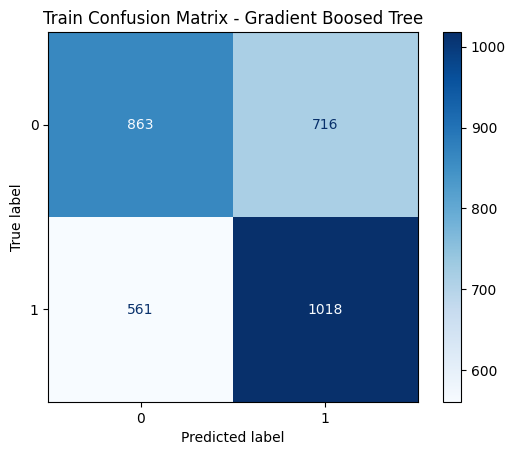

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_train_gd = confusion_matrix(y_train_1, y_pred_gd_train)
disp_train_4 = ConfusionMatrixDisplay(cm_train_gd, display_labels=best_gd.classes_)
disp_train_4.plot(cmap='Blues')
plt.title("Train Confusion Matrix - Gradient Boosed Tree")
plt.show()

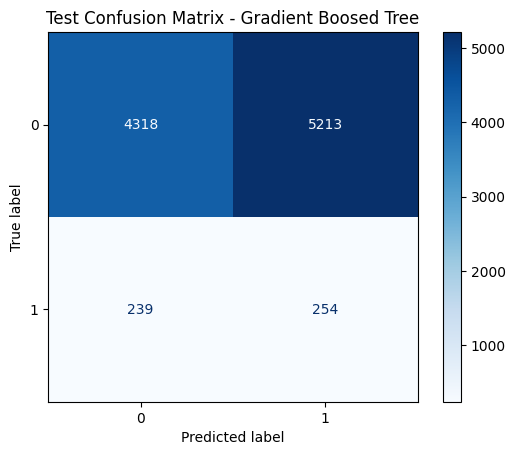

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_test_gd = confusion_matrix(y_test, y_pred_gd_test)
disp_test_5 = ConfusionMatrixDisplay(cm_test_gd, display_labels=best_gd.classes_)
disp_test_5.plot(cmap='Blues')
plt.title("Test Confusion Matrix - Gradient Boosed Tree")
plt.show()

In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_train_1, y_pred_gd_train))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.61      0.55      0.57      1579
           1       0.59      0.64      0.61      1579

    accuracy                           0.60      3158
   macro avg       0.60      0.60      0.59      3158
weighted avg       0.60      0.60      0.59      3158



In [ ]:
# === Classification Report ===
print("=== Classification Report: TRAIN ===")
print(classification_report(y_test, y_pred_gd_test))

=== Classification Report: TRAIN ===
              precision    recall  f1-score   support

           0       0.95      0.45      0.61      9531
           1       0.05      0.52      0.09       493

    accuracy                           0.46     10024
   macro avg       0.50      0.48      0.35     10024
weighted avg       0.90      0.46      0.59     10024



In [ ]:
# === ROC Curve ===
fpr_tr_4, tpr_tr_4, _ = roc_curve(y_train_1, y_prob_gd_train)
fpr_te_4, tpr_te_4, _ = roc_curve(y_test,  y_prob_gd_test)
auc_tr_4 = auc(fpr_tr_4, tpr_tr_4)
auc_te_4 = auc(fpr_te_4, tpr_te_4)

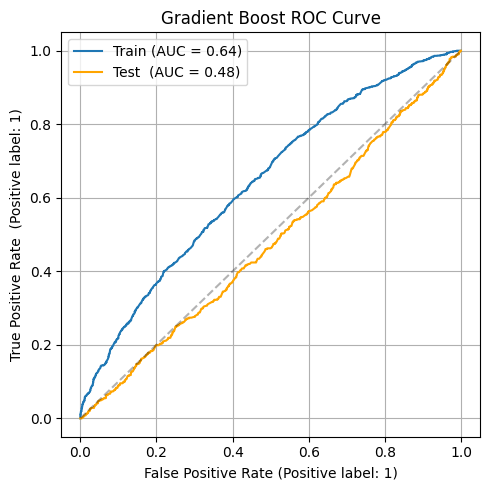

In [ ]:
plt.figure(figsize=(5,5))
plt.plot(fpr_tr_4, tpr_tr_4, label=f"Train (AUC = {auc_tr_4:.2f})")
plt.plot(fpr_te_4, tpr_te_4, label=f"Test  (AUC = {auc_te_4:.2f})", color='orange')
plt.plot([0,1],[0,1],'k--', alpha=0.3)
plt.xlabel("False Positive Rate (Positive label: 1)")
plt.ylabel("True Positive Rate  (Positive label: 1)")
plt.title("Gradient Boost ROC Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

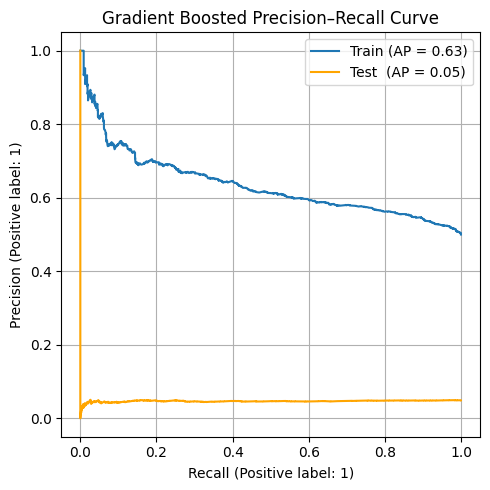

In [ ]:
# === Precision–Recall Curve ===
prec_tr_4, rec_tr_4, _ = precision_recall_curve(y_train_1, y_prob_gd_train)
prec_te_4, rec_te_4, _ = precision_recall_curve(y_test, y_prob_gd_test)
ap_tr_4 = average_precision_score(y_train_1, y_prob_gd_train)
ap_te_4 = average_precision_score(y_test,  y_prob_gd_test)

plt.figure(figsize=(5,5))
plt.plot(rec_tr_4, prec_tr_4, label=f"Train (AP = {ap_tr_4:.2f})")
plt.plot(rec_te_4, prec_te_4, label=f"Test  (AP = {ap_te_4:.2f})", color='orange')
plt.xlabel("Recall (Positive label: 1)")
plt.ylabel("Precision (Positive label: 1)")
plt.title("Gradient Boosted Precision–Recall Curve")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## Support Vektor Machine

In [ ]:
# A. Logistic Regression (Baseline Model)
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# GridSearchCV for tuning parameter
svc = SVC()
param_svc = {
    'C': [0.1, 1, 10],
    'gamma': [1, 0.1, 0.01],
    'kernel': ['rbf', 'linear']
    #'max_depth': [3, 5, 7]
}

svc_gridcv = GridSearchCV(svc, param_svc, cv=5, scoring='recall')
svc_gridcv.fit(X_train_1, y_train_1)

## CatBoost

In [ ]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 5.8 MB/s eta 0:00:00


In [ ]:
from catboost import CatBoostClassifier, Pool, cv
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    classification_report,
    roc_curve, auc,
    precision_recall_curve, average_precision_score
)
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
# GridSearchCV for tuning parameter
cb = CatBoostClassifier(random_state = 42)
param_cb = {
    'iterations': [100, 300],
    'learning_rate': [0.01, 0.1],
    'depth': [4, 6, 8]
    #'max_depth': [3, 5, 7]
}

cb_gridcv = GridSearchCV(cb, param_cb, cv=5, scoring='recall')
cb_gridcv.fit(X_train_1, y_train_1)

Output streaming akan dipotong hingga 5000 baris terakhir.
0:	learn: 0.6899908	total: 2.45ms	remaining: 734ms
1:	learn: 0.6867150	total: 8.42ms	remaining: 1.25s
2:	learn: 0.6847620	total: 10.7ms	remaining: 1.06s
3:	learn: 0.6831080	total: 18.3ms	remaining: 1.36s
4:	learn: 0.6814236	total: 20.1ms	remaining: 1.18s
5:	learn: 0.6779053	total: 21.7ms	remaining: 1.06s
6:	learn: 0.6754907	total: 23.2ms	remaining: 973ms
7:	learn: 0.6730172	total: 24.8ms	remaining: 905ms
8:	learn: 0.6714170	total: 26.3ms	remaining: 851ms
9:	learn: 0.6689457	total: 27.9ms	remaining: 808ms
10:	learn: 0.6668264	total: 29.4ms	remaining: 771ms
11:	learn: 0.6648674	total: 31ms	remaining: 744ms
12:	learn: 0.6626415	total: 32.7ms	remaining: 723ms
13:	learn: 0.6603087	total: 34.3ms	remaining: 700ms
14:	learn: 0.6575080	total: 35.8ms	remaining: 680ms
15:	learn: 0.6558218	total: 37.3ms	remaining: 662ms
16:	learn: 0.6541110	total: 38.8ms	remaining: 646ms
17:	learn: 0.6524978	total: 40.3ms	remaining: 632ms
18:	learn: 0.6508

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x7b5c21efa090>,
             param_grid={'depth': [4, 6, 8], 'iterations': [100, 300],
                         'learning_rate': [0.01, 0.1]},
             scoring='recall')

In [ ]:
best_cb = cb_gridcv.best_estimator_

In [ ]:
# Predictions
y_pred_cb_test = best_cb.predict(X_test)
y_pred_cb_train = best_cb.predict(X_train_1)
y_prob_cb_train = best_cb.predict_proba(X_train_1)[:,1]
y_prob_cb_test = best_cb.predict_proba(X_test)[:,1]

CatBoostError: Bad value for num_feature[non_default_doc_idx=0,feature_idx=1]="POS Payment": Cannot convert 'POS Payment' to float

In [ ]:
# === Confusion Matrix - TRAIN ===
cm_train_cb = confusion_matrix(y_train_1, y_pred_cb_train)
disp_train_6 = ConfusionMatrixDisplay(cm_train_cb, display_labels=best_cb.classes_)
disp_train_6.plot(cmap='Blues')
plt.title("Train Confusion Matrix - CatBoost")
plt.show()

# Feature Importance

## A. XGBoost

In [ ]:
import shap
explainer = shap.Explainer(best_xgb)
shap_values = explainer(X_test)
shap.initjs()

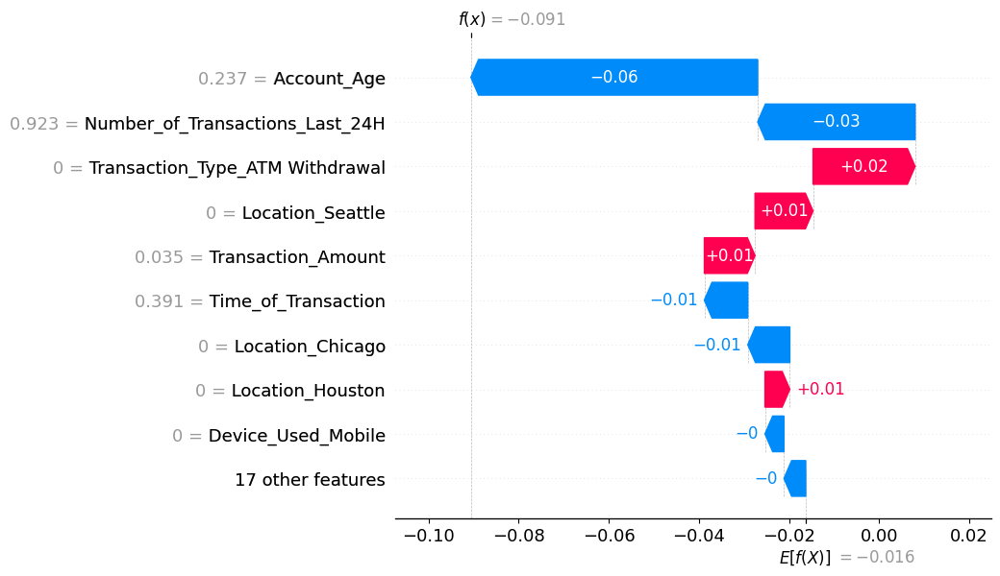

In [ ]:
shap.waterfall_plot(shap_values[0])

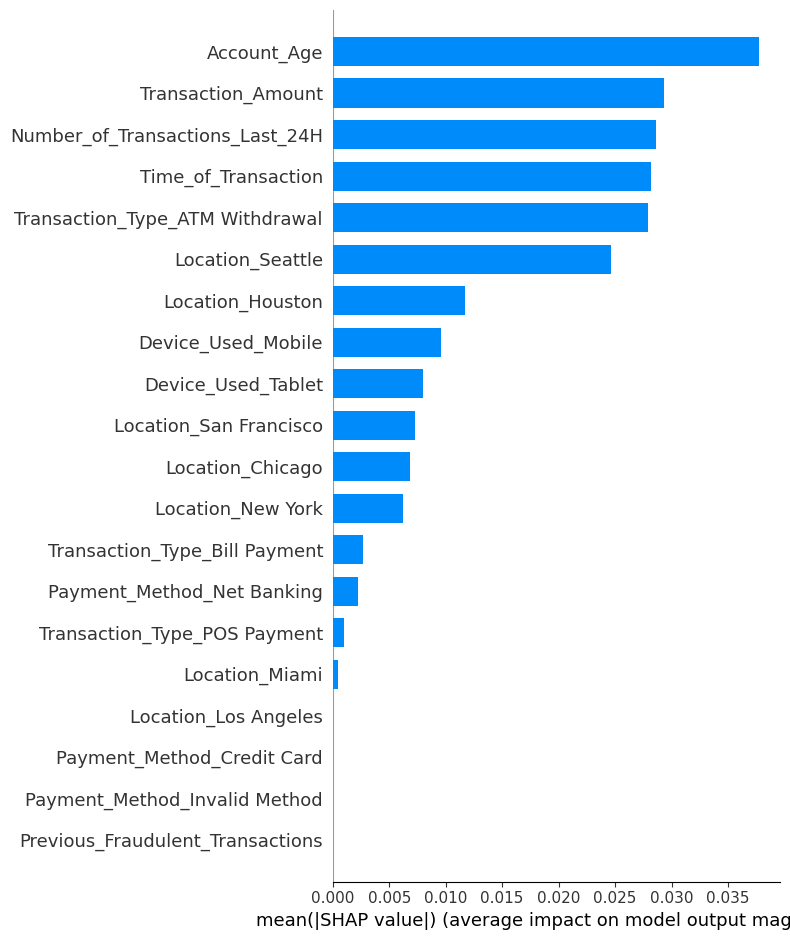

In [ ]:
shap.summary_plot(shap_values, X_test, plot_type="bar")

## B. Random Forest

In [ ]:
import shap

In [ ]:
# Fits the explainer
explainer = shap.Explainer(best_rf.predict, X_test)
# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)

PermutationExplainer explainer: 10025it [06:56, 23.71it/s]                           


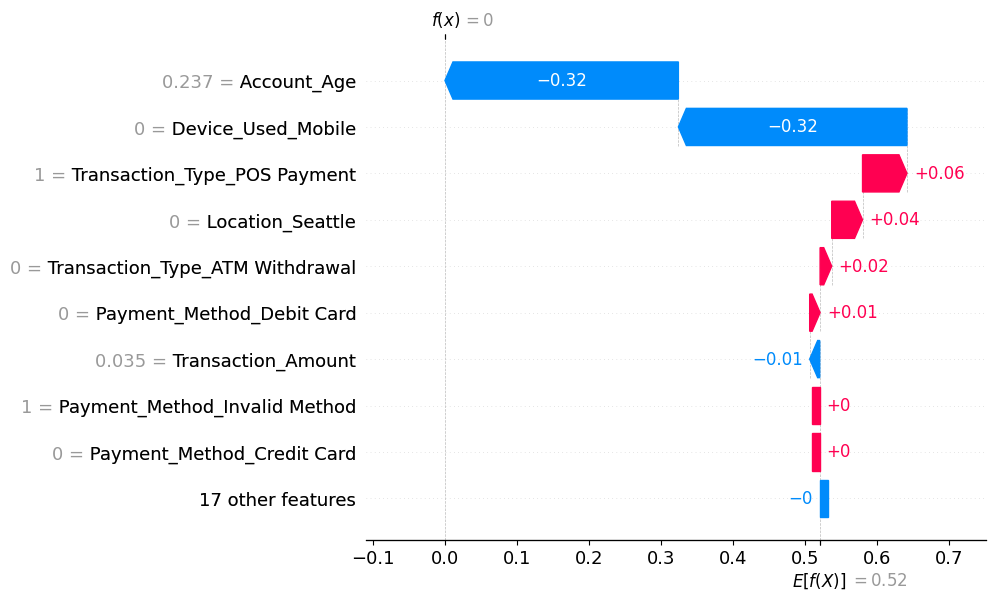

In [ ]:
shap.plots.waterfall(shap_values[0])

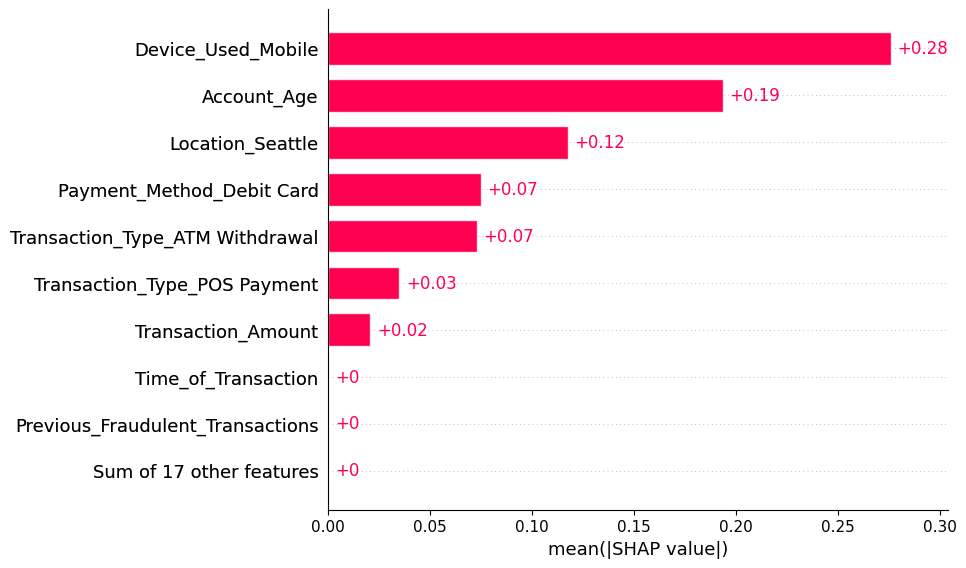

In [ ]:
shap.plots.bar(shap_values)

## C. Logistic Regression

In [ ]:
# Fits the explainer
explainer_1 = shap.Explainer(best_logreg.predict, X_test)
# Calculates the SHAP values - It takes some time
shap_values_1 = explainer_1(X_test)

PermutationExplainer explainer: 10025it [07:29, 21.84it/s]


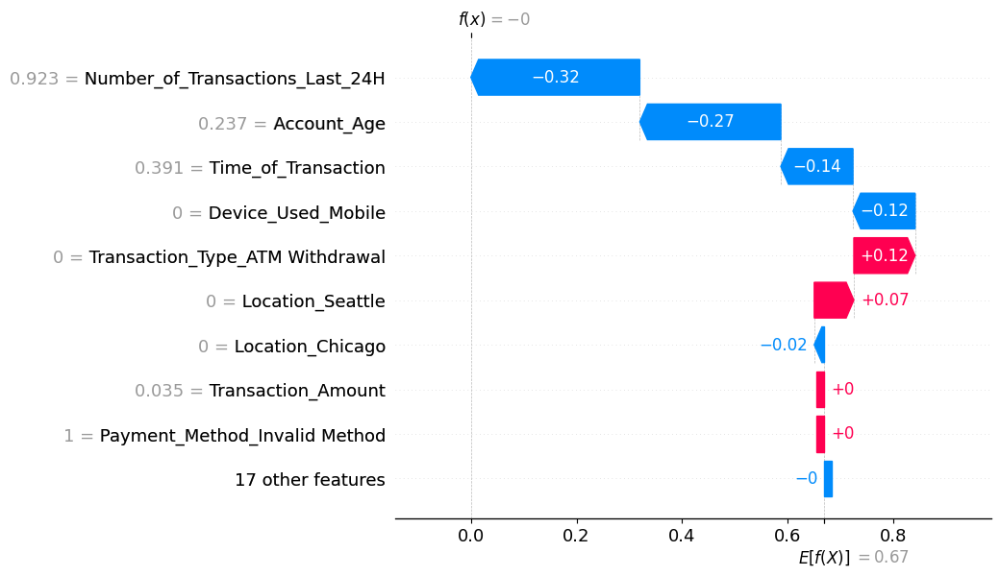

In [ ]:
shap.plots.waterfall(shap_values_1[0])

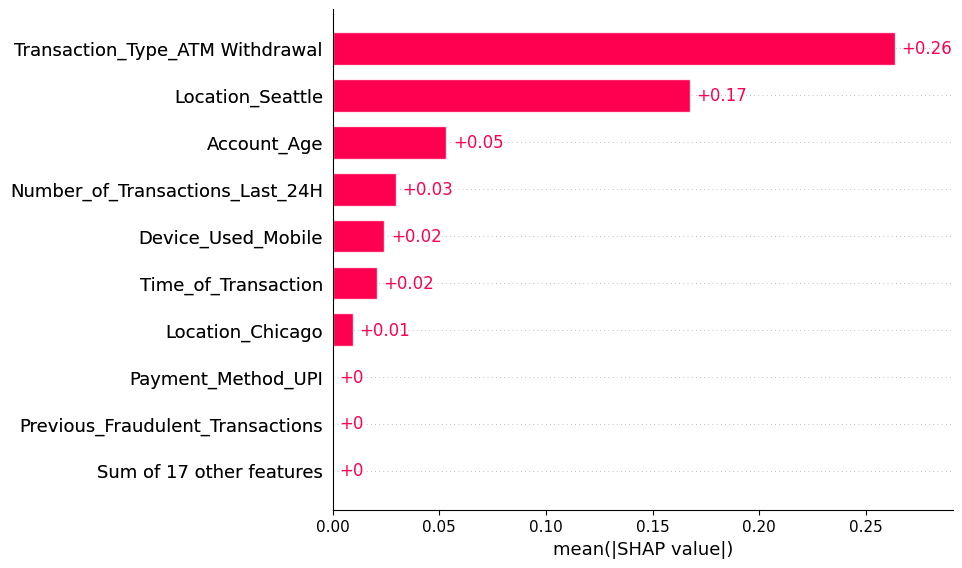

In [ ]:
shap.plots.bar(shap_values_1)